# Afriat

In [1]:
scan=0.1275

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

# tardis.MyModel.setup_wandb(
#     wandb_configurations=tardis.config.wandb,
#     hyperparams=dict(
#         model_params=model_params,
#         train_params=train_params,
#         dataset_params=dataset_params,
#     )
# )

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(
GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2563,3277,9403
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2563,2580,1670,3463,1640,3327
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4473,10770
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 642,832,2336
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 642,622,438,827,409,872
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1111,2699
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:13<2:16:46, 13.70s/it]

Epoch 1/600:   0%|          | 1/600 [00:13<2:16:46, 13.70s/it, v_num=1, total_loss_train=3.68e+3, kl_local_train=52.2]

Epoch 2/600:   0%|          | 1/600 [00:13<2:16:46, 13.70s/it, v_num=1, total_loss_train=3.68e+3, kl_local_train=52.2]

Epoch 2/600:   0%|          | 2/600 [00:26<2:08:50, 12.93s/it, v_num=1, total_loss_train=3.68e+3, kl_local_train=52.2]

Epoch 2/600:   0%|          | 2/600 [00:26<2:08:50, 12.93s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=78.6]

Epoch 3/600:   0%|          | 2/600 [00:26<2:08:50, 12.93s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=78.6]

Epoch 3/600:   0%|          | 3/600 [00:38<2:05:54, 12.65s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=78.6]

Epoch 3/600:   0%|          | 3/600 [00:38<2:05:54, 12.65s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=80.2] 

Epoch 4/600:   0%|          | 3/600 [00:38<2:05:54, 12.65s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=80.2]

Epoch 4/600:   1%|          | 4/600 [00:50<2:04:45, 12.56s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=80.2]

Epoch 4/600:   1%|          | 4/600 [00:50<2:04:45, 12.56s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=77.1]

Epoch 5/600:   1%|          | 4/600 [00:50<2:04:45, 12.56s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=77.1]

Epoch 5/600:   1%|          | 5/600 [01:03<2:04:21, 12.54s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=77.1]

Epoch 5/600:   1%|          | 5/600 [01:03<2:04:21, 12.54s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=70.9]

Epoch 6/600:   1%|          | 5/600 [01:04<2:04:21, 12.54s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=70.9]

Epoch 6/600:   1%|          | 6/600 [01:18<2:13:20, 13.47s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=70.9]

Epoch 6/600:   1%|          | 6/600 [01:18<2:13:20, 13.47s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=61.7, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00803, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 6/600 [01:18<2:13:20, 13.47s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=61.7, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00803, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:32<2:14:49, 13.64s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=61.7, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00803, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:32<2:14:49, 13.64s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00803, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|          | 7/600 [01:32<2:14:49, 13.64s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00803, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:46<2:15:33, 13.74s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00803, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:46<2:15:33, 13.74s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=31.8, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00803, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 9/600:   1%|▏         | 8/600 [01:46<2:15:33, 13.74s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=31.8, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00803, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [02:00<2:15:49, 13.79s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=31.8, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00803, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [02:00<2:15:49, 13.79s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=30.7, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00803, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 9/600 [02:00<2:15:49, 13.79s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=30.7, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00803, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:14<2:16:13, 13.85s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=30.7, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00803, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:14<2:16:13, 13.85s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=33.2, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00803, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 10/600 [02:15<2:16:13, 13.85s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=33.2, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00803, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:29<2:20:17, 14.29s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=33.2, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00803, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:29<2:20:17, 14.29s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0229, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.044]  

Epoch 12/600:   2%|▏         | 11/600 [02:29<2:20:17, 14.29s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0229, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.044]

Epoch 12/600:   2%|▏         | 12/600 [02:43<2:18:54, 14.17s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0229, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.044]

Epoch 12/600:   2%|▏         | 12/600 [02:43<2:18:54, 14.17s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0229, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.044]

Epoch 13/600:   2%|▏         | 12/600 [02:43<2:18:54, 14.17s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0229, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.044]

Epoch 13/600:   2%|▏         | 13/600 [02:57<2:17:50, 14.09s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0229, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.044]

Epoch 13/600:   2%|▏         | 13/600 [02:57<2:17:50, 14.09s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0229, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.044]

Epoch 14/600:   2%|▏         | 13/600 [02:57<2:17:50, 14.09s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0229, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.044]

Epoch 14/600:   2%|▏         | 14/600 [03:11<2:17:01, 14.03s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0229, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.044]

Epoch 14/600:   2%|▏         | 14/600 [03:11<2:17:01, 14.03s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0229, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.044]

Epoch 15/600:   2%|▏         | 14/600 [03:11<2:17:01, 14.03s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0229, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.044]

Epoch 15/600:   2%|▎         | 15/600 [03:25<2:16:41, 14.02s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0229, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.044]

Epoch 15/600:   2%|▎         | 15/600 [03:25<2:16:41, 14.02s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0229, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.044]

Epoch 16/600:   2%|▎         | 15/600 [03:26<2:16:41, 14.02s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0229, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.044]

Epoch 16/600:   3%|▎         | 16/600 [03:40<2:20:15, 14.41s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0229, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0178, metric_mi|mouse_train=0.044]

Epoch 16/600:   3%|▎         | 16/600 [03:40<2:20:15, 14.41s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=55.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0625]

Epoch 17/600:   3%|▎         | 16/600 [03:40<2:20:15, 14.41s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=55.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0625]

Epoch 17/600:   3%|▎         | 17/600 [03:54<2:18:29, 14.25s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=55.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0625]

Epoch 17/600:   3%|▎         | 17/600 [03:54<2:18:29, 14.25s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=59.3, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0625]

Epoch 18/600:   3%|▎         | 17/600 [03:54<2:18:29, 14.25s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=59.3, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0625]

Epoch 18/600:   3%|▎         | 18/600 [04:08<2:17:12, 14.14s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=59.3, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0625]

Epoch 18/600:   3%|▎         | 18/600 [04:08<2:17:12, 14.14s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=63.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0625]

Epoch 19/600:   3%|▎         | 18/600 [04:08<2:17:12, 14.14s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=63.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0625]

Epoch 19/600:   3%|▎         | 19/600 [04:22<2:16:13, 14.07s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=63.4, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0625]

Epoch 19/600:   3%|▎         | 19/600 [04:22<2:16:13, 14.07s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=70.3, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0625]

Epoch 20/600:   3%|▎         | 19/600 [04:22<2:16:13, 14.07s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=70.3, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0625]

Epoch 20/600:   3%|▎         | 20/600 [04:36<2:15:43, 14.04s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=70.3, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0625]

Epoch 20/600:   3%|▎         | 20/600 [04:36<2:15:43, 14.04s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.1, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0625]

Epoch 21/600:   3%|▎         | 20/600 [04:37<2:15:43, 14.04s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.1, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0625]

Epoch 21/600:   4%|▎         | 21/600 [04:51<2:19:03, 14.41s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.1, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0421, metric_mi|mouse_train=0.0625]

Epoch 21/600:   4%|▎         | 21/600 [04:51<2:19:03, 14.41s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=80.8, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 22/600:   4%|▎         | 21/600 [04:51<2:19:03, 14.41s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=80.8, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 22/600:   4%|▎         | 22/600 [05:05<2:17:32, 14.28s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=80.8, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 22/600:   4%|▎         | 22/600 [05:05<2:17:32, 14.28s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=87.3, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 23/600:   4%|▎         | 22/600 [05:05<2:17:32, 14.28s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=87.3, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 23/600:   4%|▍         | 23/600 [05:19<2:16:17, 14.17s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=87.3, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 23/600:   4%|▍         | 23/600 [05:19<2:16:17, 14.17s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=94.7, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 24/600:   4%|▍         | 23/600 [05:19<2:16:17, 14.17s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=94.7, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 24/600:   4%|▍         | 24/600 [05:33<2:15:20, 14.10s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=94.7, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 24/600:   4%|▍         | 24/600 [05:33<2:15:20, 14.10s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804] 

Epoch 25/600:   4%|▍         | 24/600 [05:33<2:15:20, 14.10s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 25/600:   4%|▍         | 25/600 [05:47<2:15:08, 14.10s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 25/600:   4%|▍         | 25/600 [05:47<2:15:08, 14.10s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 26/600:   4%|▍         | 25/600 [05:48<2:15:08, 14.10s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 26/600:   4%|▍         | 26/600 [06:03<2:19:55, 14.63s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0631, metric_mi|mouse_train=0.0804]

Epoch 26/600:   4%|▍         | 26/600 [06:03<2:19:55, 14.63s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0694, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.097] 

Epoch 27/600:   4%|▍         | 26/600 [06:03<2:19:55, 14.63s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0694, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.097]

Epoch 27/600:   4%|▍         | 27/600 [06:17<2:17:41, 14.42s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0694, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.097]

Epoch 27/600:   4%|▍         | 27/600 [06:17<2:17:41, 14.42s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0694, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.097]

Epoch 28/600:   4%|▍         | 27/600 [06:17<2:17:41, 14.42s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0694, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.097]

Epoch 28/600:   5%|▍         | 28/600 [06:31<2:16:00, 14.27s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0694, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.097]

Epoch 28/600:   5%|▍         | 28/600 [06:31<2:16:00, 14.27s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0694, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.097]

Epoch 29/600:   5%|▍         | 28/600 [06:31<2:16:00, 14.27s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0694, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.097]

Epoch 29/600:   5%|▍         | 29/600 [06:45<2:14:50, 14.17s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0694, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.097]

Epoch 29/600:   5%|▍         | 29/600 [06:45<2:14:50, 14.17s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0694, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.097]

Epoch 30/600:   5%|▍         | 29/600 [06:45<2:14:50, 14.17s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0694, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.097]

Epoch 30/600:   5%|▌         | 30/600 [06:59<2:14:15, 14.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0694, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.097]

Epoch 30/600:   5%|▌         | 30/600 [06:59<2:14:15, 14.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0694, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.097]

Epoch 31/600:   5%|▌         | 30/600 [07:00<2:14:15, 14.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0694, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.097]

Epoch 31/600:   5%|▌         | 31/600 [07:15<2:19:01, 14.66s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0653, metric_mi|zone_train=0.0694, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.097]

Epoch 31/600:   5%|▌         | 31/600 [07:15<2:19:01, 14.66s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=111, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.108] 

Epoch 32/600:   5%|▌         | 31/600 [07:15<2:19:01, 14.66s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=111, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.108]

Epoch 32/600:   5%|▌         | 32/600 [07:29<2:18:29, 14.63s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=111, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.108]

Epoch 32/600:   5%|▌         | 32/600 [07:29<2:18:29, 14.63s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.108]

Epoch 33/600:   5%|▌         | 32/600 [07:29<2:18:29, 14.63s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.108]

Epoch 33/600:   6%|▌         | 33/600 [07:44<2:18:04, 14.61s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.108]

Epoch 33/600:   6%|▌         | 33/600 [07:44<2:18:04, 14.61s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.108]

Epoch 34/600:   6%|▌         | 33/600 [07:44<2:18:04, 14.61s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.108]

Epoch 34/600:   6%|▌         | 34/600 [07:58<2:17:44, 14.60s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.108]

Epoch 34/600:   6%|▌         | 34/600 [07:58<2:17:44, 14.60s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=99.8, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.108]

Epoch 35/600:   6%|▌         | 34/600 [07:58<2:17:44, 14.60s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=99.8, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.108]

Epoch 35/600:   6%|▌         | 35/600 [08:13<2:17:22, 14.59s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=99.8, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.108]

Epoch 35/600:   6%|▌         | 35/600 [08:13<2:17:22, 14.59s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=98.8, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.108]

Epoch 36/600:   6%|▌         | 35/600 [08:14<2:17:22, 14.59s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=98.8, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.108]

Epoch 36/600:   6%|▌         | 36/600 [08:29<2:20:44, 14.97s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=98.8, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0992, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.108]

Epoch 36/600:   6%|▌         | 36/600 [08:29<2:20:44, 14.97s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]   

Epoch 37/600:   6%|▌         | 36/600 [08:29<2:20:44, 14.97s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 37/600:   6%|▌         | 37/600 [08:43<2:19:18, 14.85s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 37/600:   6%|▌         | 37/600 [08:43<2:19:18, 14.85s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=97.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 38/600:   6%|▌         | 37/600 [08:43<2:19:18, 14.85s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=97.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 38/600:   6%|▋         | 38/600 [08:58<2:18:13, 14.76s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=97.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 38/600:   6%|▋         | 38/600 [08:58<2:18:13, 14.76s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=97.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 39/600:   6%|▋         | 38/600 [08:58<2:18:13, 14.76s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=97.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 39/600:   6%|▋         | 39/600 [09:12<2:17:25, 14.70s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=97.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 39/600:   6%|▋         | 39/600 [09:12<2:17:25, 14.70s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=96, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]  

Epoch 40/600:   6%|▋         | 39/600 [09:12<2:17:25, 14.70s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=96, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 40/600:   7%|▋         | 40/600 [09:27<2:16:50, 14.66s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=96, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 40/600:   7%|▋         | 40/600 [09:27<2:16:50, 14.66s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 41/600:   7%|▋         | 40/600 [09:28<2:16:50, 14.66s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 41/600:   7%|▋         | 41/600 [09:43<2:20:12, 15.05s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.114]

Epoch 41/600:   7%|▋         | 41/600 [09:43<2:20:12, 15.05s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=94.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116] 

Epoch 42/600:   7%|▋         | 41/600 [09:43<2:20:12, 15.05s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=94.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 42/600:   7%|▋         | 42/600 [09:58<2:18:41, 14.91s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=94.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 42/600:   7%|▋         | 42/600 [09:58<2:18:41, 14.91s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=93.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 43/600:   7%|▋         | 42/600 [09:58<2:18:41, 14.91s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=93.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 43/600:   7%|▋         | 43/600 [10:12<2:18:09, 14.88s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=93.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 43/600:   7%|▋         | 43/600 [10:12<2:18:09, 14.88s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=93.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 44/600:   7%|▋         | 43/600 [10:12<2:18:09, 14.88s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=93.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 44/600:   7%|▋         | 44/600 [10:27<2:17:08, 14.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=93.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 44/600:   7%|▋         | 44/600 [10:27<2:17:08, 14.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 45/600:   7%|▋         | 44/600 [10:27<2:17:08, 14.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 45/600:   8%|▊         | 45/600 [10:42<2:16:18, 14.74s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 45/600:   8%|▊         | 45/600 [10:42<2:16:18, 14.74s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116] 

Epoch 46/600:   8%|▊         | 45/600 [10:43<2:16:18, 14.74s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 46/600:   8%|▊         | 46/600 [10:55<2:11:38, 14.26s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.116]

Epoch 46/600:   8%|▊         | 46/600 [10:55<2:11:38, 14.26s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.119]

Epoch 47/600:   8%|▊         | 46/600 [10:55<2:11:38, 14.26s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.119]

Epoch 47/600:   8%|▊         | 47/600 [11:07<2:04:42, 13.53s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.119]

Epoch 47/600:   8%|▊         | 47/600 [11:07<2:04:42, 13.53s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.119]

Epoch 48/600:   8%|▊         | 47/600 [11:07<2:04:42, 13.53s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.119]

Epoch 48/600:   8%|▊         | 48/600 [11:18<1:59:47, 13.02s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.119]

Epoch 48/600:   8%|▊         | 48/600 [11:18<1:59:47, 13.02s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.119]

Epoch 49/600:   8%|▊         | 48/600 [11:18<1:59:47, 13.02s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.119]

Epoch 49/600:   8%|▊         | 49/600 [11:30<1:56:12, 12.65s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.119]

Epoch 49/600:   8%|▊         | 49/600 [11:30<1:56:12, 12.65s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=93.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.119]

Epoch 50/600:   8%|▊         | 49/600 [11:30<1:56:12, 12.65s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=93.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.119]

Epoch 50/600:   8%|▊         | 50/600 [11:42<1:53:45, 12.41s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=93.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.119]

Epoch 50/600:   8%|▊         | 50/600 [11:42<1:53:45, 12.41s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.119]

Epoch 51/600:   8%|▊         | 50/600 [11:43<1:53:45, 12.41s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.119]

Epoch 51/600:   8%|▊         | 51/600 [11:55<1:55:36, 12.64s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.119]

Epoch 51/600:   8%|▊         | 51/600 [11:55<1:55:36, 12.64s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=93.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121] 

Epoch 52/600:   8%|▊         | 51/600 [11:55<1:55:36, 12.64s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=93.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 52/600:   9%|▊         | 52/600 [12:07<1:53:12, 12.40s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=93.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 52/600:   9%|▊         | 52/600 [12:07<1:53:12, 12.40s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]   

Epoch 53/600:   9%|▊         | 52/600 [12:07<1:53:12, 12.40s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 53/600:   9%|▉         | 53/600 [12:19<1:51:29, 12.23s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 53/600:   9%|▉         | 53/600 [12:19<1:51:29, 12.23s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 54/600:   9%|▉         | 53/600 [12:19<1:51:29, 12.23s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 54/600:   9%|▉         | 54/600 [12:31<1:50:14, 12.11s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 54/600:   9%|▉         | 54/600 [12:31<1:50:14, 12.11s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 55/600:   9%|▉         | 54/600 [12:31<1:50:14, 12.11s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 55/600:   9%|▉         | 55/600 [12:43<1:49:17, 12.03s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 55/600:   9%|▉         | 55/600 [12:43<1:49:17, 12.03s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 56/600:   9%|▉         | 55/600 [12:44<1:49:17, 12.03s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 56/600:   9%|▉         | 56/600 [12:56<1:52:05, 12.36s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.121]

Epoch 56/600:   9%|▉         | 56/600 [12:56<1:52:05, 12.36s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 57/600:   9%|▉         | 56/600 [12:56<1:52:05, 12.36s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 57/600:  10%|▉         | 57/600 [13:08<1:50:30, 12.21s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 57/600:  10%|▉         | 57/600 [13:08<1:50:30, 12.21s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 58/600:  10%|▉         | 57/600 [13:08<1:50:30, 12.21s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 58/600:  10%|▉         | 58/600 [13:19<1:49:18, 12.10s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 58/600:  10%|▉         | 58/600 [13:19<1:49:18, 12.10s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=89.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 59/600:  10%|▉         | 58/600 [13:19<1:49:18, 12.10s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=89.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 59/600:  10%|▉         | 59/600 [13:31<1:48:23, 12.02s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=89.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 59/600:  10%|▉         | 59/600 [13:31<1:48:23, 12.02s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 60/600:  10%|▉         | 59/600 [13:31<1:48:23, 12.02s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 60/600:  10%|█         | 60/600 [13:43<1:47:57, 12.00s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 60/600:  10%|█         | 60/600 [13:43<1:47:57, 12.00s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=87.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 61/600:  10%|█         | 60/600 [13:44<1:47:57, 12.00s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=87.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 61/600:  10%|█         | 61/600 [13:56<1:50:53, 12.34s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=87.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.121]

Epoch 61/600:  10%|█         | 61/600 [13:56<1:50:53, 12.34s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12] 

Epoch 62/600:  10%|█         | 61/600 [13:56<1:50:53, 12.34s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 62/600:  10%|█         | 62/600 [14:08<1:49:22, 12.20s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 62/600:  10%|█         | 62/600 [14:08<1:49:22, 12.20s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]  

Epoch 63/600:  10%|█         | 62/600 [14:08<1:49:22, 12.20s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 63/600:  10%|█         | 63/600 [14:20<1:48:15, 12.10s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 63/600:  10%|█         | 63/600 [14:20<1:48:15, 12.10s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 64/600:  10%|█         | 63/600 [14:20<1:48:15, 12.10s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 64/600:  11%|█         | 64/600 [14:32<1:47:22, 12.02s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 64/600:  11%|█         | 64/600 [14:32<1:47:22, 12.02s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=84.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 65/600:  11%|█         | 64/600 [14:32<1:47:22, 12.02s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=84.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 65/600:  11%|█         | 65/600 [14:44<1:48:17, 12.15s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=84.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 65/600:  11%|█         | 65/600 [14:44<1:48:17, 12.15s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=84.1, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 66/600:  11%|█         | 65/600 [14:46<1:48:17, 12.15s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=84.1, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 66/600:  11%|█         | 66/600 [14:57<1:50:46, 12.45s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=84.1, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 66/600:  11%|█         | 66/600 [14:57<1:50:46, 12.45s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 67/600:  11%|█         | 66/600 [14:57<1:50:46, 12.45s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 67/600:  11%|█         | 67/600 [15:09<1:49:15, 12.30s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 67/600:  11%|█         | 67/600 [15:09<1:49:15, 12.30s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=84, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]  

Epoch 68/600:  11%|█         | 67/600 [15:09<1:49:15, 12.30s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=84, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 68/600:  11%|█▏        | 68/600 [15:21<1:48:03, 12.19s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=84, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 68/600:  11%|█▏        | 68/600 [15:21<1:48:03, 12.19s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 69/600:  11%|█▏        | 68/600 [15:21<1:48:03, 12.19s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 69/600:  12%|█▏        | 69/600 [15:33<1:47:09, 12.11s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 69/600:  12%|█▏        | 69/600 [15:33<1:47:09, 12.11s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.8, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 70/600:  12%|█▏        | 69/600 [15:33<1:47:09, 12.11s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.8, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 70/600:  12%|█▏        | 70/600 [15:45<1:46:21, 12.04s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.8, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 70/600:  12%|█▏        | 70/600 [15:45<1:46:21, 12.04s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]  

Epoch 71/600:  12%|█▏        | 70/600 [15:46<1:46:21, 12.04s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 71/600:  12%|█▏        | 71/600 [15:58<1:49:13, 12.39s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 71/600:  12%|█▏        | 71/600 [15:58<1:49:13, 12.39s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 72/600:  12%|█▏        | 71/600 [15:58<1:49:13, 12.39s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 72/600:  12%|█▏        | 72/600 [16:10<1:47:39, 12.23s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 72/600:  12%|█▏        | 72/600 [16:10<1:47:39, 12.23s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 73/600:  12%|█▏        | 72/600 [16:10<1:47:39, 12.23s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 73/600:  12%|█▏        | 73/600 [16:22<1:46:30, 12.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 73/600:  12%|█▏        | 73/600 [16:22<1:46:30, 12.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 74/600:  12%|█▏        | 73/600 [16:22<1:46:30, 12.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 74/600:  12%|█▏        | 74/600 [16:34<1:45:39, 12.05s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 74/600:  12%|█▏        | 74/600 [16:34<1:45:39, 12.05s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 75/600:  12%|█▏        | 74/600 [16:34<1:45:39, 12.05s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 75/600:  12%|█▎        | 75/600 [16:46<1:45:18, 12.03s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 75/600:  12%|█▎        | 75/600 [16:46<1:45:18, 12.03s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 76/600:  12%|█▎        | 75/600 [16:47<1:45:18, 12.03s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 76/600:  13%|█▎        | 76/600 [16:59<1:48:09, 12.38s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.115]

Epoch 76/600:  13%|█▎        | 76/600 [16:59<1:48:09, 12.38s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 77/600:  13%|█▎        | 76/600 [16:59<1:48:09, 12.38s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 77/600:  13%|█▎        | 77/600 [17:11<1:46:38, 12.23s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 77/600:  13%|█▎        | 77/600 [17:11<1:46:38, 12.23s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 78/600:  13%|█▎        | 77/600 [17:11<1:46:38, 12.23s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 78/600:  13%|█▎        | 78/600 [17:23<1:45:31, 12.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 78/600:  13%|█▎        | 78/600 [17:23<1:45:31, 12.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 79/600:  13%|█▎        | 78/600 [17:23<1:45:31, 12.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 79/600:  13%|█▎        | 79/600 [17:35<1:44:40, 12.05s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 79/600:  13%|█▎        | 79/600 [17:35<1:44:40, 12.05s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 80/600:  13%|█▎        | 79/600 [17:35<1:44:40, 12.05s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 80/600:  13%|█▎        | 80/600 [17:47<1:44:15, 12.03s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 80/600:  13%|█▎        | 80/600 [17:47<1:44:15, 12.03s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 81/600:  13%|█▎        | 80/600 [17:48<1:44:15, 12.03s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 81/600:  14%|█▎        | 81/600 [18:00<1:47:07, 12.38s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 81/600:  14%|█▎        | 81/600 [18:00<1:47:07, 12.38s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]  

Epoch 82/600:  14%|█▎        | 81/600 [18:00<1:47:07, 12.38s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 82/600:  14%|█▎        | 82/600 [18:12<1:45:42, 12.24s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 82/600:  14%|█▎        | 82/600 [18:12<1:45:42, 12.24s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 83/600:  14%|█▎        | 82/600 [18:12<1:45:42, 12.24s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 83/600:  14%|█▍        | 83/600 [18:24<1:44:37, 12.14s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 83/600:  14%|█▍        | 83/600 [18:24<1:44:37, 12.14s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 84/600:  14%|█▍        | 83/600 [18:24<1:44:37, 12.14s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 84/600:  14%|█▍        | 84/600 [18:36<1:43:47, 12.07s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 84/600:  14%|█▍        | 84/600 [18:36<1:43:47, 12.07s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 85/600:  14%|█▍        | 84/600 [18:36<1:43:47, 12.07s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 85/600:  14%|█▍        | 85/600 [18:48<1:43:14, 12.03s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 85/600:  14%|█▍        | 85/600 [18:48<1:43:14, 12.03s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 86/600:  14%|█▍        | 85/600 [18:49<1:43:14, 12.03s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 86/600:  14%|█▍        | 86/600 [19:01<1:46:05, 12.38s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 86/600:  14%|█▍        | 86/600 [19:01<1:46:05, 12.38s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 87/600:  14%|█▍        | 86/600 [19:01<1:46:05, 12.38s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 87/600:  14%|█▍        | 87/600 [19:13<1:44:40, 12.24s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 87/600:  14%|█▍        | 87/600 [19:13<1:44:40, 12.24s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 88/600:  14%|█▍        | 87/600 [19:13<1:44:40, 12.24s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 88/600:  15%|█▍        | 88/600 [19:25<1:43:39, 12.15s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 88/600:  15%|█▍        | 88/600 [19:25<1:43:39, 12.15s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 89/600:  15%|█▍        | 88/600 [19:25<1:43:39, 12.15s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 89/600:  15%|█▍        | 89/600 [19:37<1:42:50, 12.08s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 89/600:  15%|█▍        | 89/600 [19:37<1:42:50, 12.08s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 90/600:  15%|█▍        | 89/600 [19:37<1:42:50, 12.08s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 90/600:  15%|█▌        | 90/600 [19:49<1:42:09, 12.02s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 90/600:  15%|█▌        | 90/600 [19:49<1:42:09, 12.02s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 91/600:  15%|█▌        | 90/600 [19:50<1:42:09, 12.02s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 91/600:  15%|█▌        | 91/600 [20:02<1:44:59, 12.38s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 91/600:  15%|█▌        | 91/600 [20:02<1:44:59, 12.38s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 92/600:  15%|█▌        | 91/600 [20:02<1:44:59, 12.38s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 92/600:  15%|█▌        | 92/600 [20:14<1:43:40, 12.24s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 92/600:  15%|█▌        | 92/600 [20:14<1:43:40, 12.24s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]  

Epoch 93/600:  15%|█▌        | 92/600 [20:14<1:43:40, 12.24s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 93/600:  16%|█▌        | 93/600 [20:26<1:42:48, 12.17s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 93/600:  16%|█▌        | 93/600 [20:26<1:42:48, 12.17s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 94/600:  16%|█▌        | 93/600 [20:26<1:42:48, 12.17s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 94/600:  16%|█▌        | 94/600 [20:38<1:41:59, 12.09s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 94/600:  16%|█▌        | 94/600 [20:38<1:41:59, 12.09s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 95/600:  16%|█▌        | 94/600 [20:38<1:41:59, 12.09s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 95/600:  16%|█▌        | 95/600 [20:50<1:41:28, 12.06s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 95/600:  16%|█▌        | 95/600 [20:50<1:41:28, 12.06s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]  

Epoch 96/600:  16%|█▌        | 95/600 [20:51<1:41:28, 12.06s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 96/600:  16%|█▌        | 96/600 [21:03<1:43:59, 12.38s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 96/600:  16%|█▌        | 96/600 [21:03<1:43:59, 12.38s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 97/600:  16%|█▌        | 96/600 [21:03<1:43:59, 12.38s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 97/600:  16%|█▌        | 97/600 [21:14<1:42:21, 12.21s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 97/600:  16%|█▌        | 97/600 [21:14<1:42:21, 12.21s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 98/600:  16%|█▌        | 97/600 [21:14<1:42:21, 12.21s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 98/600:  16%|█▋        | 98/600 [21:26<1:41:11, 12.10s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 98/600:  16%|█▋        | 98/600 [21:26<1:41:11, 12.10s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 99/600:  16%|█▋        | 98/600 [21:26<1:41:11, 12.10s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 99/600:  16%|█▋        | 99/600 [21:38<1:40:18, 12.01s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 99/600:  16%|█▋        | 99/600 [21:38<1:40:18, 12.01s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 100/600:  16%|█▋        | 99/600 [21:38<1:40:18, 12.01s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 100/600:  17%|█▋        | 100/600 [21:50<1:39:35, 11.95s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 100/600:  17%|█▋        | 100/600 [21:50<1:39:35, 11.95s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 101/600:  17%|█▋        | 100/600 [21:51<1:39:35, 11.95s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 101/600:  17%|█▋        | 101/600 [22:03<1:42:17, 12.30s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.107]

Epoch 101/600:  17%|█▋        | 101/600 [22:03<1:42:17, 12.30s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105] 

Epoch 102/600:  17%|█▋        | 101/600 [22:03<1:42:17, 12.30s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 102/600:  17%|█▋        | 102/600 [22:15<1:40:49, 12.15s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 102/600:  17%|█▋        | 102/600 [22:15<1:40:49, 12.15s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 103/600:  17%|█▋        | 102/600 [22:15<1:40:49, 12.15s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 103/600:  17%|█▋        | 103/600 [22:27<1:39:45, 12.04s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 103/600:  17%|█▋        | 103/600 [22:27<1:39:45, 12.04s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 104/600:  17%|█▋        | 103/600 [22:27<1:39:45, 12.04s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 104/600:  17%|█▋        | 104/600 [22:38<1:38:56, 11.97s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 104/600:  17%|█▋        | 104/600 [22:38<1:38:56, 11.97s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]  

Epoch 105/600:  17%|█▋        | 104/600 [22:38<1:38:56, 11.97s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 105/600:  18%|█▊        | 105/600 [22:50<1:38:23, 11.93s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 105/600:  18%|█▊        | 105/600 [22:50<1:38:23, 11.93s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 106/600:  18%|█▊        | 105/600 [22:52<1:38:23, 11.93s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 106/600:  18%|█▊        | 106/600 [23:03<1:41:08, 12.29s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 106/600:  18%|█▊        | 106/600 [23:03<1:41:08, 12.29s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 107/600:  18%|█▊        | 106/600 [23:03<1:41:08, 12.29s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 107/600:  18%|█▊        | 107/600 [23:15<1:39:47, 12.14s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 107/600:  18%|█▊        | 107/600 [23:15<1:39:47, 12.14s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 108/600:  18%|█▊        | 107/600 [23:15<1:39:47, 12.14s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 108/600:  18%|█▊        | 108/600 [23:27<1:38:46, 12.05s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 108/600:  18%|█▊        | 108/600 [23:27<1:38:46, 12.05s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 109/600:  18%|█▊        | 108/600 [23:27<1:38:46, 12.05s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 109/600:  18%|█▊        | 109/600 [23:39<1:37:58, 11.97s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 109/600:  18%|█▊        | 109/600 [23:39<1:37:58, 11.97s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 110/600:  18%|█▊        | 109/600 [23:39<1:37:58, 11.97s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 110/600:  18%|█▊        | 110/600 [23:51<1:37:24, 11.93s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 110/600:  18%|█▊        | 110/600 [23:51<1:37:24, 11.93s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 111/600:  18%|█▊        | 110/600 [23:52<1:37:24, 11.93s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 111/600:  18%|█▊        | 111/600 [24:04<1:40:05, 12.28s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 111/600:  18%|█▊        | 111/600 [24:04<1:40:05, 12.28s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]  

Epoch 112/600:  18%|█▊        | 111/600 [24:04<1:40:05, 12.28s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 112/600:  19%|█▊        | 112/600 [24:16<1:38:46, 12.15s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 112/600:  19%|█▊        | 112/600 [24:16<1:38:46, 12.15s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 113/600:  19%|█▊        | 112/600 [24:16<1:38:46, 12.15s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 113/600:  19%|█▉        | 113/600 [24:27<1:37:46, 12.05s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 113/600:  19%|█▉        | 113/600 [24:27<1:37:46, 12.05s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 114/600:  19%|█▉        | 113/600 [24:27<1:37:46, 12.05s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 114/600:  19%|█▉        | 114/600 [24:39<1:36:59, 11.97s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 114/600:  19%|█▉        | 114/600 [24:39<1:36:59, 11.97s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]  

Epoch 115/600:  19%|█▉        | 114/600 [24:39<1:36:59, 11.97s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 115/600:  19%|█▉        | 115/600 [24:51<1:36:29, 11.94s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 115/600:  19%|█▉        | 115/600 [24:51<1:36:29, 11.94s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 116/600:  19%|█▉        | 115/600 [24:52<1:36:29, 11.94s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 116/600:  19%|█▉        | 116/600 [25:04<1:39:19, 12.31s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 116/600:  19%|█▉        | 116/600 [25:04<1:39:19, 12.31s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 117/600:  19%|█▉        | 116/600 [25:04<1:39:19, 12.31s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 117/600:  20%|█▉        | 117/600 [25:16<1:38:01, 12.18s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 117/600:  20%|█▉        | 117/600 [25:16<1:38:01, 12.18s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]  

Epoch 118/600:  20%|█▉        | 117/600 [25:16<1:38:01, 12.18s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 118/600:  20%|█▉        | 118/600 [25:28<1:37:17, 12.11s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 118/600:  20%|█▉        | 118/600 [25:28<1:37:17, 12.11s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 119/600:  20%|█▉        | 118/600 [25:28<1:37:17, 12.11s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 119/600:  20%|█▉        | 119/600 [25:40<1:36:30, 12.04s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 119/600:  20%|█▉        | 119/600 [25:40<1:36:30, 12.04s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 120/600:  20%|█▉        | 119/600 [25:40<1:36:30, 12.04s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 120/600:  20%|██        | 120/600 [25:52<1:35:52, 11.98s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 120/600:  20%|██        | 120/600 [25:52<1:35:52, 11.98s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 121/600:  20%|██        | 120/600 [25:53<1:35:52, 11.98s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 121/600:  20%|██        | 121/600 [26:05<1:38:28, 12.33s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 121/600:  20%|██        | 121/600 [26:05<1:38:28, 12.33s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 122/600:  20%|██        | 121/600 [26:05<1:38:28, 12.33s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 122/600:  20%|██        | 122/600 [26:17<1:37:05, 12.19s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 122/600:  20%|██        | 122/600 [26:17<1:37:05, 12.19s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 123/600:  20%|██        | 122/600 [26:17<1:37:05, 12.19s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 123/600:  20%|██        | 123/600 [26:29<1:36:03, 12.08s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 123/600:  20%|██        | 123/600 [26:29<1:36:03, 12.08s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]  

Epoch 124/600:  20%|██        | 123/600 [26:29<1:36:03, 12.08s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 124/600:  21%|██        | 124/600 [26:40<1:35:15, 12.01s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 124/600:  21%|██        | 124/600 [26:40<1:35:15, 12.01s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 125/600:  21%|██        | 124/600 [26:40<1:35:15, 12.01s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 125/600:  21%|██        | 125/600 [26:52<1:34:37, 11.95s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 125/600:  21%|██        | 125/600 [26:52<1:34:37, 11.95s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 126/600:  21%|██        | 125/600 [26:54<1:34:37, 11.95s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 126/600:  21%|██        | 126/600 [27:05<1:37:12, 12.30s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.106]

Epoch 126/600:  21%|██        | 126/600 [27:05<1:37:12, 12.30s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 127/600:  21%|██        | 126/600 [27:05<1:37:12, 12.30s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 127/600:  21%|██        | 127/600 [27:17<1:35:52, 12.16s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 127/600:  21%|██        | 127/600 [27:17<1:35:52, 12.16s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 128/600:  21%|██        | 127/600 [27:17<1:35:52, 12.16s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 128/600:  21%|██▏       | 128/600 [27:29<1:34:54, 12.06s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 128/600:  21%|██▏       | 128/600 [27:29<1:34:54, 12.06s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 129/600:  21%|██▏       | 128/600 [27:29<1:34:54, 12.06s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 129/600:  22%|██▏       | 129/600 [27:41<1:34:12, 12.00s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 129/600:  22%|██▏       | 129/600 [27:41<1:34:12, 12.00s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 130/600:  22%|██▏       | 129/600 [27:41<1:34:12, 12.00s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 130/600:  22%|██▏       | 130/600 [27:53<1:33:37, 11.95s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 130/600:  22%|██▏       | 130/600 [27:53<1:33:37, 11.95s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 131/600:  22%|██▏       | 130/600 [27:54<1:33:37, 11.95s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 131/600:  22%|██▏       | 131/600 [28:06<1:37:28, 12.47s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 131/600:  22%|██▏       | 131/600 [28:06<1:37:28, 12.47s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.101] 

Epoch 132/600:  22%|██▏       | 131/600 [28:06<1:37:28, 12.47s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.101]

Epoch 132/600:  22%|██▏       | 132/600 [28:18<1:35:49, 12.28s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.101]

Epoch 132/600:  22%|██▏       | 132/600 [28:18<1:35:49, 12.28s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.101]

Epoch 133/600:  22%|██▏       | 132/600 [28:18<1:35:49, 12.28s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.101]

Epoch 133/600:  22%|██▏       | 133/600 [28:30<1:34:34, 12.15s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.101]

Epoch 133/600:  22%|██▏       | 133/600 [28:30<1:34:34, 12.15s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.101]

Epoch 134/600:  22%|██▏       | 133/600 [28:30<1:34:34, 12.15s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.101]

Epoch 134/600:  22%|██▏       | 134/600 [28:42<1:33:37, 12.06s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.101]

Epoch 134/600:  22%|██▏       | 134/600 [28:42<1:33:37, 12.06s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.101]

Epoch 135/600:  22%|██▏       | 134/600 [28:42<1:33:37, 12.06s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.101]

Epoch 135/600:  22%|██▎       | 135/600 [28:54<1:33:55, 12.12s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.101]

Epoch 135/600:  22%|██▎       | 135/600 [28:54<1:33:55, 12.12s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.101]  

Epoch 136/600:  22%|██▎       | 135/600 [28:56<1:33:55, 12.12s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.101]

Epoch 136/600:  23%|██▎       | 136/600 [29:07<1:36:04, 12.42s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.101]

Epoch 136/600:  23%|██▎       | 136/600 [29:07<1:36:04, 12.42s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0986]

Epoch 137/600:  23%|██▎       | 136/600 [29:07<1:36:04, 12.42s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0986]

Epoch 137/600:  23%|██▎       | 137/600 [29:19<1:34:32, 12.25s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0986]

Epoch 137/600:  23%|██▎       | 137/600 [29:19<1:34:32, 12.25s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0986]

Epoch 138/600:  23%|██▎       | 137/600 [29:19<1:34:32, 12.25s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0986]

Epoch 138/600:  23%|██▎       | 138/600 [29:31<1:33:24, 12.13s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0986]

Epoch 138/600:  23%|██▎       | 138/600 [29:31<1:33:24, 12.13s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0986]

Epoch 139/600:  23%|██▎       | 138/600 [29:31<1:33:24, 12.13s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0986]

Epoch 139/600:  23%|██▎       | 139/600 [29:43<1:32:35, 12.05s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0986]

Epoch 139/600:  23%|██▎       | 139/600 [29:43<1:32:35, 12.05s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0986]

Epoch 140/600:  23%|██▎       | 139/600 [29:43<1:32:35, 12.05s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0986]

Epoch 140/600:  23%|██▎       | 140/600 [29:55<1:31:53, 11.99s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0986]

Epoch 140/600:  23%|██▎       | 140/600 [29:55<1:31:53, 11.99s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0986]

Epoch 141/600:  23%|██▎       | 140/600 [29:56<1:31:53, 11.99s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0986]

Epoch 141/600:  24%|██▎       | 141/600 [30:08<1:34:20, 12.33s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0986]

Epoch 141/600:  24%|██▎       | 141/600 [30:08<1:34:20, 12.33s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0969]

Epoch 142/600:  24%|██▎       | 141/600 [30:08<1:34:20, 12.33s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0969]

Epoch 142/600:  24%|██▎       | 142/600 [30:20<1:33:02, 12.19s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0969]

Epoch 142/600:  24%|██▎       | 142/600 [30:20<1:33:02, 12.19s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0969] 

Epoch 143/600:  24%|██▎       | 142/600 [30:20<1:33:02, 12.19s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0969]

Epoch 143/600:  24%|██▍       | 143/600 [30:32<1:32:07, 12.10s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0969]

Epoch 143/600:  24%|██▍       | 143/600 [30:32<1:32:07, 12.10s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0969]

Epoch 144/600:  24%|██▍       | 143/600 [30:32<1:32:07, 12.10s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0969]

Epoch 144/600:  24%|██▍       | 144/600 [30:44<1:31:24, 12.03s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0969]

Epoch 144/600:  24%|██▍       | 144/600 [30:44<1:31:24, 12.03s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0969]

Epoch 145/600:  24%|██▍       | 144/600 [30:44<1:31:24, 12.03s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0969]

Epoch 145/600:  24%|██▍       | 145/600 [30:55<1:30:56, 11.99s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0969]

Epoch 145/600:  24%|██▍       | 145/600 [30:55<1:30:56, 11.99s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0969]  

Epoch 146/600:  24%|██▍       | 145/600 [30:57<1:30:56, 11.99s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0969]

Epoch 146/600:  24%|██▍       | 146/600 [31:09<1:33:19, 12.33s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0901, metric_mi|mouse_train=0.0969]

Epoch 146/600:  24%|██▍       | 146/600 [31:09<1:33:19, 12.33s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0955]

Epoch 147/600:  24%|██▍       | 146/600 [31:09<1:33:19, 12.33s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0955]

Epoch 147/600:  24%|██▍       | 147/600 [31:20<1:32:02, 12.19s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0955]

Epoch 147/600:  24%|██▍       | 147/600 [31:20<1:32:02, 12.19s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0955]

Epoch 148/600:  24%|██▍       | 147/600 [31:20<1:32:02, 12.19s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0955]

Epoch 148/600:  25%|██▍       | 148/600 [31:32<1:31:02, 12.08s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0955]

Epoch 148/600:  25%|██▍       | 148/600 [31:32<1:31:02, 12.08s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0955]

Epoch 149/600:  25%|██▍       | 148/600 [31:32<1:31:02, 12.08s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0955]

Epoch 149/600:  25%|██▍       | 149/600 [31:44<1:30:16, 12.01s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0955]

Epoch 149/600:  25%|██▍       | 149/600 [31:44<1:30:16, 12.01s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0955]

Epoch 150/600:  25%|██▍       | 149/600 [31:44<1:30:16, 12.01s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0955]

Epoch 150/600:  25%|██▌       | 150/600 [31:56<1:29:43, 11.96s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0955]

Epoch 150/600:  25%|██▌       | 150/600 [31:56<1:29:43, 11.96s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0955]

Epoch 151/600:  25%|██▌       | 150/600 [31:57<1:29:43, 11.96s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0955]

Epoch 151/600:  25%|██▌       | 151/600 [32:09<1:32:10, 12.32s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0955]

Epoch 151/600:  25%|██▌       | 151/600 [32:09<1:32:10, 12.32s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0952]

Epoch 152/600:  25%|██▌       | 151/600 [32:09<1:32:10, 12.32s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0952]

Epoch 152/600:  25%|██▌       | 152/600 [32:21<1:30:55, 12.18s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0952]

Epoch 152/600:  25%|██▌       | 152/600 [32:21<1:30:55, 12.18s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0952]

Epoch 153/600:  25%|██▌       | 152/600 [32:21<1:30:55, 12.18s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0952]

Epoch 153/600:  26%|██▌       | 153/600 [32:33<1:29:58, 12.08s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0952]

Epoch 153/600:  26%|██▌       | 153/600 [32:33<1:29:58, 12.08s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0952]

Epoch 154/600:  26%|██▌       | 153/600 [32:33<1:29:58, 12.08s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0952]

Epoch 154/600:  26%|██▌       | 154/600 [32:45<1:29:14, 12.01s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.2, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0952]

Epoch 154/600:  26%|██▌       | 154/600 [32:45<1:29:14, 12.01s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0952]

Epoch 155/600:  26%|██▌       | 154/600 [32:45<1:29:14, 12.01s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0952]

Epoch 155/600:  26%|██▌       | 155/600 [32:56<1:28:39, 11.95s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0952]

Epoch 155/600:  26%|██▌       | 155/600 [32:56<1:28:39, 11.95s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0952]  

Epoch 156/600:  26%|██▌       | 155/600 [32:58<1:28:39, 11.95s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0952]

Epoch 156/600:  26%|██▌       | 156/600 [33:10<1:31:10, 12.32s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.088, metric_mi|mouse_train=0.0952]

Epoch 156/600:  26%|██▌       | 156/600 [33:10<1:31:10, 12.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0943]

Epoch 157/600:  26%|██▌       | 156/600 [33:10<1:31:10, 12.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0943]

Epoch 157/600:  26%|██▌       | 157/600 [33:21<1:29:56, 12.18s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0943]

Epoch 157/600:  26%|██▌       | 157/600 [33:21<1:29:56, 12.18s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0943]

Epoch 158/600:  26%|██▌       | 157/600 [33:21<1:29:56, 12.18s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0943]

Epoch 158/600:  26%|██▋       | 158/600 [33:33<1:28:58, 12.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0943]

Epoch 158/600:  26%|██▋       | 158/600 [33:33<1:28:58, 12.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0943]

Epoch 159/600:  26%|██▋       | 158/600 [33:33<1:28:58, 12.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0943]

Epoch 159/600:  26%|██▋       | 159/600 [33:45<1:28:13, 12.00s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0943]

Epoch 159/600:  26%|██▋       | 159/600 [33:45<1:28:13, 12.00s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0943]

Epoch 160/600:  26%|██▋       | 159/600 [33:45<1:28:13, 12.00s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0943]

Epoch 160/600:  27%|██▋       | 160/600 [33:57<1:27:40, 11.96s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0943]

Epoch 160/600:  27%|██▋       | 160/600 [33:57<1:27:40, 11.96s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0943]

Epoch 161/600:  27%|██▋       | 160/600 [33:58<1:27:40, 11.96s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0943]

Epoch 161/600:  27%|██▋       | 161/600 [34:10<1:30:03, 12.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0943]

Epoch 161/600:  27%|██▋       | 161/600 [34:10<1:30:03, 12.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0934]

Epoch 162/600:  27%|██▋       | 161/600 [34:10<1:30:03, 12.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0934]

Epoch 162/600:  27%|██▋       | 162/600 [34:22<1:28:52, 12.17s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0934]

Epoch 162/600:  27%|██▋       | 162/600 [34:22<1:28:52, 12.17s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0934]  

Epoch 163/600:  27%|██▋       | 162/600 [34:22<1:28:52, 12.17s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0934]

Epoch 163/600:  27%|██▋       | 163/600 [34:34<1:27:57, 12.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0934]

Epoch 163/600:  27%|██▋       | 163/600 [34:34<1:27:57, 12.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0934]

Epoch 164/600:  27%|██▋       | 163/600 [34:34<1:27:57, 12.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0934]

Epoch 164/600:  27%|██▋       | 164/600 [34:46<1:27:15, 12.01s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0934]

Epoch 164/600:  27%|██▋       | 164/600 [34:46<1:27:15, 12.01s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0934]

Epoch 165/600:  27%|██▋       | 164/600 [34:46<1:27:15, 12.01s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0934]

Epoch 165/600:  28%|██▊       | 165/600 [34:58<1:26:43, 11.96s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0934]

Epoch 165/600:  28%|██▊       | 165/600 [34:58<1:26:43, 11.96s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0934]

Epoch 166/600:  28%|██▊       | 165/600 [34:59<1:26:43, 11.96s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0934]

Epoch 166/600:  28%|██▊       | 166/600 [35:11<1:29:08, 12.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0934]

Epoch 166/600:  28%|██▊       | 166/600 [35:11<1:29:08, 12.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 167/600:  28%|██▊       | 166/600 [35:11<1:29:08, 12.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 167/600:  28%|██▊       | 167/600 [35:23<1:27:56, 12.18s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 167/600:  28%|██▊       | 167/600 [35:23<1:27:56, 12.18s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 168/600:  28%|██▊       | 167/600 [35:23<1:27:56, 12.18s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 168/600:  28%|██▊       | 168/600 [35:34<1:27:04, 12.09s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 168/600:  28%|██▊       | 168/600 [35:34<1:27:04, 12.09s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 169/600:  28%|██▊       | 168/600 [35:34<1:27:04, 12.09s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 169/600:  28%|██▊       | 169/600 [35:46<1:26:37, 12.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 169/600:  28%|██▊       | 169/600 [35:46<1:26:37, 12.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 170/600:  28%|██▊       | 169/600 [35:46<1:26:37, 12.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 170/600:  28%|██▊       | 170/600 [35:58<1:26:01, 12.00s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 170/600:  28%|██▊       | 170/600 [35:58<1:26:01, 12.00s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]  

Epoch 171/600:  28%|██▊       | 170/600 [36:00<1:26:01, 12.00s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 171/600:  28%|██▊       | 171/600 [36:11<1:28:14, 12.34s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 171/600:  28%|██▊       | 171/600 [36:11<1:28:14, 12.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0908]

Epoch 172/600:  28%|██▊       | 171/600 [36:11<1:28:14, 12.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0908]

Epoch 172/600:  29%|██▊       | 172/600 [36:23<1:27:00, 12.20s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0908]

Epoch 172/600:  29%|██▊       | 172/600 [36:23<1:27:00, 12.20s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0908]

Epoch 173/600:  29%|██▊       | 172/600 [36:23<1:27:00, 12.20s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0908]

Epoch 173/600:  29%|██▉       | 173/600 [36:35<1:26:02, 12.09s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0908]

Epoch 173/600:  29%|██▉       | 173/600 [36:35<1:26:02, 12.09s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0908]

Epoch 174/600:  29%|██▉       | 173/600 [36:35<1:26:02, 12.09s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0908]

Epoch 174/600:  29%|██▉       | 174/600 [36:47<1:25:17, 12.01s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0908]

Epoch 174/600:  29%|██▉       | 174/600 [36:47<1:25:17, 12.01s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0908]

Epoch 175/600:  29%|██▉       | 174/600 [36:47<1:25:17, 12.01s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0908]

Epoch 175/600:  29%|██▉       | 175/600 [36:59<1:24:46, 11.97s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0908]

Epoch 175/600:  29%|██▉       | 175/600 [36:59<1:24:46, 11.97s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0908]

Epoch 176/600:  29%|██▉       | 175/600 [37:00<1:24:46, 11.97s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0908]

Epoch 176/600:  29%|██▉       | 176/600 [37:12<1:27:03, 12.32s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0908]

Epoch 176/600:  29%|██▉       | 176/600 [37:12<1:27:03, 12.32s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0889] 

Epoch 177/600:  29%|██▉       | 176/600 [37:12<1:27:03, 12.32s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0889]

Epoch 177/600:  30%|██▉       | 177/600 [37:24<1:25:49, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0889]

Epoch 177/600:  30%|██▉       | 177/600 [37:24<1:25:49, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0889]

Epoch 178/600:  30%|██▉       | 177/600 [37:24<1:25:49, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0889]

Epoch 178/600:  30%|██▉       | 178/600 [37:36<1:24:55, 12.07s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0889]

Epoch 178/600:  30%|██▉       | 178/600 [37:36<1:24:55, 12.07s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0889]

Epoch 179/600:  30%|██▉       | 178/600 [37:36<1:24:55, 12.07s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0889]

Epoch 179/600:  30%|██▉       | 179/600 [37:47<1:24:14, 12.01s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0889]

Epoch 179/600:  30%|██▉       | 179/600 [37:47<1:24:14, 12.01s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0889]

Epoch 180/600:  30%|██▉       | 179/600 [37:47<1:24:14, 12.01s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0889]

Epoch 180/600:  30%|███       | 180/600 [37:59<1:23:39, 11.95s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0889]

Epoch 180/600:  30%|███       | 180/600 [37:59<1:23:39, 11.95s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0889]

Epoch 181/600:  30%|███       | 180/600 [38:01<1:23:39, 11.95s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0889]

Epoch 181/600:  30%|███       | 181/600 [38:12<1:25:57, 12.31s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0889]

Epoch 181/600:  30%|███       | 181/600 [38:12<1:25:57, 12.31s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0877]

Epoch 182/600:  30%|███       | 181/600 [38:12<1:25:57, 12.31s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0877]

Epoch 182/600:  30%|███       | 182/600 [38:24<1:24:45, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0877]

Epoch 182/600:  30%|███       | 182/600 [38:24<1:24:45, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0877]

Epoch 183/600:  30%|███       | 182/600 [38:24<1:24:45, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0877]

Epoch 183/600:  30%|███       | 183/600 [38:36<1:23:50, 12.06s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0877]

Epoch 183/600:  30%|███       | 183/600 [38:36<1:23:50, 12.06s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0877]

Epoch 184/600:  30%|███       | 183/600 [38:36<1:23:50, 12.06s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0877]

Epoch 184/600:  31%|███       | 184/600 [38:48<1:23:07, 11.99s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0877]

Epoch 184/600:  31%|███       | 184/600 [38:48<1:23:07, 11.99s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0877]

Epoch 185/600:  31%|███       | 184/600 [38:48<1:23:07, 11.99s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0877]

Epoch 185/600:  31%|███       | 185/600 [39:00<1:22:38, 11.95s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0877]

Epoch 185/600:  31%|███       | 185/600 [39:00<1:22:38, 11.95s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0877]

Epoch 186/600:  31%|███       | 185/600 [39:01<1:22:38, 11.95s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0877]

Epoch 186/600:  31%|███       | 186/600 [39:13<1:24:52, 12.30s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.0877]

Epoch 186/600:  31%|███       | 186/600 [39:13<1:24:52, 12.30s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0861]

Epoch 187/600:  31%|███       | 186/600 [39:13<1:24:52, 12.30s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0861]

Epoch 187/600:  31%|███       | 187/600 [39:25<1:23:45, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0861]

Epoch 187/600:  31%|███       | 187/600 [39:25<1:23:45, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0861]

Epoch 188/600:  31%|███       | 187/600 [39:25<1:23:45, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0861]

Epoch 188/600:  31%|███▏      | 188/600 [39:37<1:22:51, 12.07s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0861]

Epoch 188/600:  31%|███▏      | 188/600 [39:37<1:22:51, 12.07s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0861]

Epoch 189/600:  31%|███▏      | 188/600 [39:37<1:22:51, 12.07s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0861]

Epoch 189/600:  32%|███▏      | 189/600 [39:48<1:22:08, 11.99s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0861]

Epoch 189/600:  32%|███▏      | 189/600 [39:48<1:22:08, 11.99s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0861]

Epoch 190/600:  32%|███▏      | 189/600 [39:48<1:22:08, 11.99s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0861]

Epoch 190/600:  32%|███▏      | 190/600 [40:00<1:21:34, 11.94s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0861]

Epoch 190/600:  32%|███▏      | 190/600 [40:00<1:21:34, 11.94s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0861]

Epoch 191/600:  32%|███▏      | 190/600 [40:02<1:21:34, 11.94s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0861]

Epoch 191/600:  32%|███▏      | 191/600 [40:13<1:23:50, 12.30s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0997, metric_mi|time_cat_train=0.0735, metric_mi|mouse_train=0.0861]

Epoch 191/600:  32%|███▏      | 191/600 [40:13<1:23:50, 12.30s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0851]

Epoch 192/600:  32%|███▏      | 191/600 [40:13<1:23:50, 12.30s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0851]

Epoch 192/600:  32%|███▏      | 192/600 [40:25<1:22:42, 12.16s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0851]

Epoch 192/600:  32%|███▏      | 192/600 [40:25<1:22:42, 12.16s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0851]  

Epoch 193/600:  32%|███▏      | 192/600 [40:25<1:22:42, 12.16s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0851]

Epoch 193/600:  32%|███▏      | 193/600 [40:37<1:21:53, 12.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0851]

Epoch 193/600:  32%|███▏      | 193/600 [40:37<1:21:53, 12.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0851]

Epoch 194/600:  32%|███▏      | 193/600 [40:37<1:21:53, 12.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0851]

Epoch 194/600:  32%|███▏      | 194/600 [40:49<1:21:25, 12.03s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0851]

Epoch 194/600:  32%|███▏      | 194/600 [40:49<1:21:25, 12.03s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0851]

Epoch 195/600:  32%|███▏      | 194/600 [40:49<1:21:25, 12.03s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0851]

Epoch 195/600:  32%|███▎      | 195/600 [41:01<1:20:50, 11.98s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0851]

Epoch 195/600:  32%|███▎      | 195/600 [41:01<1:20:50, 11.98s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0851]

Epoch 196/600:  32%|███▎      | 195/600 [41:02<1:20:50, 11.98s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0851]

Epoch 196/600:  33%|███▎      | 196/600 [41:14<1:23:08, 12.35s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0851]

Epoch 196/600:  33%|███▎      | 196/600 [41:14<1:23:08, 12.35s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0845]

Epoch 197/600:  33%|███▎      | 196/600 [41:14<1:23:08, 12.35s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0845]

Epoch 197/600:  33%|███▎      | 197/600 [41:26<1:22:09, 12.23s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0845]

Epoch 197/600:  33%|███▎      | 197/600 [41:26<1:22:09, 12.23s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0845]

Epoch 198/600:  33%|███▎      | 197/600 [41:26<1:22:09, 12.23s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0845]

Epoch 198/600:  33%|███▎      | 198/600 [41:38<1:21:20, 12.14s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0845]

Epoch 198/600:  33%|███▎      | 198/600 [41:38<1:21:20, 12.14s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0845]

Epoch 199/600:  33%|███▎      | 198/600 [41:38<1:21:20, 12.14s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0845]

Epoch 199/600:  33%|███▎      | 199/600 [41:50<1:20:41, 12.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0845]

Epoch 199/600:  33%|███▎      | 199/600 [41:50<1:20:41, 12.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0845]

Epoch 200/600:  33%|███▎      | 199/600 [41:50<1:20:41, 12.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0845]

Epoch 200/600:  33%|███▎      | 200/600 [42:02<1:20:17, 12.04s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0845]

Epoch 200/600:  33%|███▎      | 200/600 [42:02<1:20:17, 12.04s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0845]  

Epoch 201/600:  33%|███▎      | 200/600 [42:03<1:20:17, 12.04s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0845]

Epoch 201/600:  34%|███▎      | 201/600 [42:15<1:22:27, 12.40s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.0711, metric_mi|mouse_train=0.0845]

Epoch 201/600:  34%|███▎      | 201/600 [42:15<1:22:27, 12.40s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0846]  

Epoch 202/600:  34%|███▎      | 201/600 [42:15<1:22:27, 12.40s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0846]

Epoch 202/600:  34%|███▎      | 202/600 [42:27<1:21:16, 12.25s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0846]

Epoch 202/600:  34%|███▎      | 202/600 [42:27<1:21:16, 12.25s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0846]

Epoch 203/600:  34%|███▎      | 202/600 [42:27<1:21:16, 12.25s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0846]

Epoch 203/600:  34%|███▍      | 203/600 [42:39<1:20:22, 12.15s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0846]

Epoch 203/600:  34%|███▍      | 203/600 [42:39<1:20:22, 12.15s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0846]

Epoch 204/600:  34%|███▍      | 203/600 [42:39<1:20:22, 12.15s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0846]

Epoch 204/600:  34%|███▍      | 204/600 [42:51<1:19:42, 12.08s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0846]

Epoch 204/600:  34%|███▍      | 204/600 [42:51<1:19:42, 12.08s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0846]

Epoch 205/600:  34%|███▍      | 204/600 [42:51<1:19:42, 12.08s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0846]

Epoch 205/600:  34%|███▍      | 205/600 [43:03<1:19:13, 12.03s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0846]

Epoch 205/600:  34%|███▍      | 205/600 [43:03<1:19:13, 12.03s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0846]

Epoch 206/600:  34%|███▍      | 205/600 [43:04<1:19:13, 12.03s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0846]

Epoch 206/600:  34%|███▍      | 206/600 [43:16<1:21:20, 12.39s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0947, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0846]

Epoch 206/600:  34%|███▍      | 206/600 [43:16<1:21:20, 12.39s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0849]

Epoch 207/600:  34%|███▍      | 206/600 [43:16<1:21:20, 12.39s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0849]

Epoch 207/600:  34%|███▍      | 207/600 [43:28<1:20:12, 12.25s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0849]

Epoch 207/600:  34%|███▍      | 207/600 [43:28<1:20:12, 12.25s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0849]

Epoch 208/600:  34%|███▍      | 207/600 [43:28<1:20:12, 12.25s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0849]

Epoch 208/600:  35%|███▍      | 208/600 [43:40<1:19:19, 12.14s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0849]

Epoch 208/600:  35%|███▍      | 208/600 [43:40<1:19:19, 12.14s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0849]

Epoch 209/600:  35%|███▍      | 208/600 [43:40<1:19:19, 12.14s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0849]

Epoch 209/600:  35%|███▍      | 209/600 [43:52<1:18:39, 12.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0849]

Epoch 209/600:  35%|███▍      | 209/600 [43:52<1:18:39, 12.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0849]

Epoch 210/600:  35%|███▍      | 209/600 [43:52<1:18:39, 12.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0849]

Epoch 210/600:  35%|███▌      | 210/600 [44:04<1:18:04, 12.01s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0849]

Epoch 210/600:  35%|███▌      | 210/600 [44:04<1:18:04, 12.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0849]

Epoch 211/600:  35%|███▌      | 210/600 [44:05<1:18:04, 12.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0849]

Epoch 211/600:  35%|███▌      | 211/600 [44:17<1:20:16, 12.38s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0935, metric_mi|time_cat_train=0.0718, metric_mi|mouse_train=0.0849]

Epoch 211/600:  35%|███▌      | 211/600 [44:17<1:20:16, 12.38s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.085]  

Epoch 212/600:  35%|███▌      | 211/600 [44:17<1:20:16, 12.38s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.085]

Epoch 212/600:  35%|███▌      | 212/600 [44:29<1:19:11, 12.25s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.085]

Epoch 212/600:  35%|███▌      | 212/600 [44:29<1:19:11, 12.25s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.085]  

Epoch 213/600:  35%|███▌      | 212/600 [44:29<1:19:11, 12.25s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.085]

Epoch 213/600:  36%|███▌      | 213/600 [44:41<1:18:20, 12.15s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.085]

Epoch 213/600:  36%|███▌      | 213/600 [44:41<1:18:20, 12.15s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.085]

Epoch 214/600:  36%|███▌      | 213/600 [44:41<1:18:20, 12.15s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.085]

Epoch 214/600:  36%|███▌      | 214/600 [44:53<1:17:41, 12.08s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.085]

Epoch 214/600:  36%|███▌      | 214/600 [44:53<1:17:41, 12.08s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.085]

Epoch 215/600:  36%|███▌      | 214/600 [44:53<1:17:41, 12.08s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.085]

Epoch 215/600:  36%|███▌      | 215/600 [45:04<1:17:16, 12.04s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.085]

Epoch 215/600:  36%|███▌      | 215/600 [45:04<1:17:16, 12.04s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.085]  

Epoch 216/600:  36%|███▌      | 215/600 [45:06<1:17:16, 12.04s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.085]

Epoch 216/600:  36%|███▌      | 216/600 [45:18<1:19:21, 12.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0915, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.085]

Epoch 216/600:  36%|███▌      | 216/600 [45:18<1:19:21, 12.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.085]

Epoch 217/600:  36%|███▌      | 216/600 [45:18<1:19:21, 12.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.085]

Epoch 217/600:  36%|███▌      | 217/600 [45:30<1:18:13, 12.26s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.085]

Epoch 217/600:  36%|███▌      | 217/600 [45:30<1:18:13, 12.26s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.085]

Epoch 218/600:  36%|███▌      | 217/600 [45:30<1:18:13, 12.26s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.085]

Epoch 218/600:  36%|███▋      | 218/600 [45:42<1:17:23, 12.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.085]

Epoch 218/600:  36%|███▋      | 218/600 [45:42<1:17:23, 12.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.085]

Epoch 219/600:  36%|███▋      | 218/600 [45:42<1:17:23, 12.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.085]

Epoch 219/600:  36%|███▋      | 219/600 [45:54<1:16:53, 12.11s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.085]

Epoch 219/600:  36%|███▋      | 219/600 [45:54<1:16:53, 12.11s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.085]

Epoch 220/600:  36%|███▋      | 219/600 [45:54<1:16:53, 12.11s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.085]

Epoch 220/600:  37%|███▋      | 220/600 [46:06<1:16:24, 12.07s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.085]

Epoch 220/600:  37%|███▋      | 220/600 [46:06<1:16:24, 12.07s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.085]

Epoch 221/600:  37%|███▋      | 220/600 [46:07<1:16:24, 12.07s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.085]

Epoch 221/600:  37%|███▋      | 221/600 [46:19<1:18:23, 12.41s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.085]

Epoch 221/600:  37%|███▋      | 221/600 [46:19<1:18:23, 12.41s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0852]

Epoch 222/600:  37%|███▋      | 221/600 [46:19<1:18:23, 12.41s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0852]

Epoch 222/600:  37%|███▋      | 222/600 [46:31<1:17:14, 12.26s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0852]

Epoch 222/600:  37%|███▋      | 222/600 [46:31<1:17:14, 12.26s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0852]

Epoch 223/600:  37%|███▋      | 222/600 [46:31<1:17:14, 12.26s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0852]

Epoch 223/600:  37%|███▋      | 223/600 [46:43<1:16:25, 12.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0852]

Epoch 223/600:  37%|███▋      | 223/600 [46:43<1:16:25, 12.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0852]

Epoch 224/600:  37%|███▋      | 223/600 [46:43<1:16:25, 12.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0852]

Epoch 224/600:  37%|███▋      | 224/600 [46:55<1:15:46, 12.09s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0852]

Epoch 224/600:  37%|███▋      | 224/600 [46:55<1:15:46, 12.09s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0852]

Epoch 225/600:  37%|███▋      | 224/600 [46:55<1:15:46, 12.09s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0852]

Epoch 225/600:  38%|███▊      | 225/600 [47:06<1:15:15, 12.04s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0852]

Epoch 225/600:  38%|███▊      | 225/600 [47:06<1:15:15, 12.04s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0852]

Epoch 226/600:  38%|███▊      | 225/600 [47:08<1:15:15, 12.04s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0852]

Epoch 226/600:  38%|███▊      | 226/600 [47:20<1:17:15, 12.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0852]

Epoch 226/600:  38%|███▊      | 226/600 [47:20<1:17:15, 12.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0861, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0856]

Epoch 227/600:  38%|███▊      | 226/600 [47:20<1:17:15, 12.40s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0861, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0856]

Epoch 227/600:  38%|███▊      | 227/600 [47:32<1:16:10, 12.25s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0861, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0856]

Epoch 227/600:  38%|███▊      | 227/600 [47:32<1:16:10, 12.25s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0861, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0856]

Epoch 228/600:  38%|███▊      | 227/600 [47:32<1:16:10, 12.25s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0861, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0856]

Epoch 228/600:  38%|███▊      | 228/600 [47:43<1:15:19, 12.15s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0861, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0856]

Epoch 228/600:  38%|███▊      | 228/600 [47:43<1:15:19, 12.15s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0861, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0856]

Epoch 229/600:  38%|███▊      | 228/600 [47:44<1:15:19, 12.15s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0861, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0856]

Epoch 229/600:  38%|███▊      | 229/600 [47:55<1:14:39, 12.08s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0861, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0856]

Epoch 229/600:  38%|███▊      | 229/600 [47:55<1:14:39, 12.08s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0861, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0856]

Epoch 230/600:  38%|███▊      | 229/600 [47:55<1:14:39, 12.08s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0861, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0856]

Epoch 230/600:  38%|███▊      | 230/600 [48:07<1:14:08, 12.02s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0861, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0856]

Epoch 230/600:  38%|███▊      | 230/600 [48:07<1:14:08, 12.02s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0861, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0856]

Epoch 231/600:  38%|███▊      | 230/600 [48:09<1:14:08, 12.02s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0861, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0856]

Epoch 231/600:  38%|███▊      | 231/600 [48:21<1:16:09, 12.38s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0861, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0856]

Epoch 231/600:  38%|███▊      | 231/600 [48:21<1:16:09, 12.38s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0854]

Epoch 232/600:  38%|███▊      | 231/600 [48:21<1:16:09, 12.38s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0854]

Epoch 232/600:  39%|███▊      | 232/600 [48:32<1:15:04, 12.24s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0854]

Epoch 232/600:  39%|███▊      | 232/600 [48:32<1:15:04, 12.24s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0854]

Epoch 233/600:  39%|███▊      | 232/600 [48:32<1:15:04, 12.24s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0854]

Epoch 233/600:  39%|███▉      | 233/600 [48:44<1:14:15, 12.14s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0854]

Epoch 233/600:  39%|███▉      | 233/600 [48:44<1:14:15, 12.14s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0854]

Epoch 234/600:  39%|███▉      | 233/600 [48:44<1:14:15, 12.14s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0854]

Epoch 234/600:  39%|███▉      | 234/600 [48:56<1:13:37, 12.07s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0854]

Epoch 234/600:  39%|███▉      | 234/600 [48:56<1:13:37, 12.07s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0854]

Epoch 235/600:  39%|███▉      | 234/600 [48:56<1:13:37, 12.07s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0854]

Epoch 235/600:  39%|███▉      | 235/600 [49:08<1:13:11, 12.03s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0854]

Epoch 235/600:  39%|███▉      | 235/600 [49:08<1:13:11, 12.03s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0854]

Epoch 236/600:  39%|███▉      | 235/600 [49:10<1:13:11, 12.03s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0854]

Epoch 236/600:  39%|███▉      | 236/600 [49:21<1:15:07, 12.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0845, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0854]

Epoch 236/600:  39%|███▉      | 236/600 [49:21<1:15:07, 12.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0848]

Epoch 237/600:  39%|███▉      | 236/600 [49:21<1:15:07, 12.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0848]

Epoch 237/600:  40%|███▉      | 237/600 [49:33<1:14:04, 12.24s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0848]

Epoch 237/600:  40%|███▉      | 237/600 [49:33<1:14:04, 12.24s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0848]

Epoch 238/600:  40%|███▉      | 237/600 [49:33<1:14:04, 12.24s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0848]

Epoch 238/600:  40%|███▉      | 238/600 [49:45<1:13:16, 12.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0848]

Epoch 238/600:  40%|███▉      | 238/600 [49:45<1:13:16, 12.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0848]

Epoch 239/600:  40%|███▉      | 238/600 [49:45<1:13:16, 12.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0848]

Epoch 239/600:  40%|███▉      | 239/600 [49:57<1:12:38, 12.07s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0848]

Epoch 239/600:  40%|███▉      | 239/600 [49:57<1:12:38, 12.07s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0848]

Epoch 240/600:  40%|███▉      | 239/600 [49:57<1:12:38, 12.07s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0848]

Epoch 240/600:  40%|████      | 240/600 [50:09<1:12:12, 12.03s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0848]

Epoch 240/600:  40%|████      | 240/600 [50:09<1:12:12, 12.03s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0848]

Epoch 241/600:  40%|████      | 240/600 [50:10<1:12:12, 12.03s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0848]

Epoch 241/600:  40%|████      | 241/600 [50:22<1:14:07, 12.39s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0937, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0848]

Epoch 241/600:  40%|████      | 241/600 [50:22<1:14:07, 12.39s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0835]

Epoch 242/600:  40%|████      | 241/600 [50:22<1:14:07, 12.39s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0835]

Epoch 242/600:  40%|████      | 242/600 [50:34<1:13:03, 12.25s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0835]

Epoch 242/600:  40%|████      | 242/600 [50:34<1:13:03, 12.25s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0835]  

Epoch 243/600:  40%|████      | 242/600 [50:34<1:13:03, 12.25s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0835]

Epoch 243/600:  40%|████      | 243/600 [50:46<1:12:18, 12.15s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0835]

Epoch 243/600:  40%|████      | 243/600 [50:46<1:12:18, 12.15s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0835]

Epoch 244/600:  40%|████      | 243/600 [50:46<1:12:18, 12.15s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0835]

Epoch 244/600:  41%|████      | 244/600 [50:58<1:12:00, 12.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0835]

Epoch 244/600:  41%|████      | 244/600 [50:58<1:12:00, 12.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0835]

Epoch 245/600:  41%|████      | 244/600 [50:58<1:12:00, 12.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0835]

Epoch 245/600:  41%|████      | 245/600 [51:10<1:11:25, 12.07s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0835]

Epoch 245/600:  41%|████      | 245/600 [51:10<1:11:25, 12.07s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0835]

Epoch 246/600:  41%|████      | 245/600 [51:11<1:11:25, 12.07s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0835]

Epoch 246/600:  41%|████      | 246/600 [51:23<1:13:20, 12.43s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0925, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0697, metric_mi|mouse_train=0.0835]

Epoch 246/600:  41%|████      | 246/600 [51:23<1:13:20, 12.43s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0805, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0824]

Epoch 247/600:  41%|████      | 246/600 [51:23<1:13:20, 12.43s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0805, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0824]

Epoch 247/600:  41%|████      | 247/600 [51:35<1:12:13, 12.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0805, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0824]

Epoch 247/600:  41%|████      | 247/600 [51:35<1:12:13, 12.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0805, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0824]

Epoch 248/600:  41%|████      | 247/600 [51:35<1:12:13, 12.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0805, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0824]

Epoch 248/600:  41%|████▏     | 248/600 [51:47<1:11:24, 12.17s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0805, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0824]

Epoch 248/600:  41%|████▏     | 248/600 [51:47<1:11:24, 12.17s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0805, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0824]

Epoch 249/600:  41%|████▏     | 248/600 [51:47<1:11:24, 12.17s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0805, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0824]

Epoch 249/600:  42%|████▏     | 249/600 [51:59<1:10:49, 12.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0805, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0824]

Epoch 249/600:  42%|████▏     | 249/600 [51:59<1:10:49, 12.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0805, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0824]

Epoch 250/600:  42%|████▏     | 249/600 [51:59<1:10:49, 12.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0805, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0824]

Epoch 250/600:  42%|████▏     | 250/600 [52:11<1:10:18, 12.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0805, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0824]

Epoch 250/600:  42%|████▏     | 250/600 [52:11<1:10:18, 12.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0805, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0824]

Epoch 251/600:  42%|████▏     | 250/600 [52:12<1:10:18, 12.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0805, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0824]

Epoch 251/600:  42%|████▏     | 251/600 [52:24<1:12:10, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0921, metric_mi|zone_train=0.0805, metric_mi|time_cat_train=0.0683, metric_mi|mouse_train=0.0824]

Epoch 251/600:  42%|████▏     | 251/600 [52:24<1:12:10, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0808]

Epoch 252/600:  42%|████▏     | 251/600 [52:24<1:12:10, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0808]

Epoch 252/600:  42%|████▏     | 252/600 [52:36<1:11:06, 12.26s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0808]

Epoch 252/600:  42%|████▏     | 252/600 [52:36<1:11:06, 12.26s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0808]

Epoch 253/600:  42%|████▏     | 252/600 [52:36<1:11:06, 12.26s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0808]

Epoch 253/600:  42%|████▏     | 253/600 [52:48<1:10:18, 12.16s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0808]

Epoch 253/600:  42%|████▏     | 253/600 [52:48<1:10:18, 12.16s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0808]

Epoch 254/600:  42%|████▏     | 253/600 [52:48<1:10:18, 12.16s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0808]

Epoch 254/600:  42%|████▏     | 254/600 [53:00<1:09:43, 12.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0808]

Epoch 254/600:  42%|████▏     | 254/600 [53:00<1:09:43, 12.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0808]  

Epoch 255/600:  42%|████▏     | 254/600 [53:00<1:09:43, 12.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0808]

Epoch 255/600:  42%|████▎     | 255/600 [53:12<1:09:18, 12.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0808]

Epoch 255/600:  42%|████▎     | 255/600 [53:12<1:09:18, 12.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0808]

Epoch 256/600:  42%|████▎     | 255/600 [53:13<1:09:18, 12.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0808]

Epoch 256/600:  43%|████▎     | 256/600 [53:25<1:11:08, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0906, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0653, metric_mi|mouse_train=0.0808]

Epoch 256/600:  43%|████▎     | 256/600 [53:25<1:11:08, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0796]  

Epoch 257/600:  43%|████▎     | 256/600 [53:25<1:11:08, 12.41s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0796]

Epoch 257/600:  43%|████▎     | 257/600 [53:37<1:10:04, 12.26s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0796]

Epoch 257/600:  43%|████▎     | 257/600 [53:37<1:10:04, 12.26s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0796]

Epoch 258/600:  43%|████▎     | 257/600 [53:37<1:10:04, 12.26s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0796]

Epoch 258/600:  43%|████▎     | 258/600 [53:49<1:09:16, 12.15s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0796]

Epoch 258/600:  43%|████▎     | 258/600 [53:49<1:09:16, 12.15s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0796]

Epoch 259/600:  43%|████▎     | 258/600 [53:49<1:09:16, 12.15s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0796]

Epoch 259/600:  43%|████▎     | 259/600 [54:01<1:08:38, 12.08s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0796]

Epoch 259/600:  43%|████▎     | 259/600 [54:01<1:08:38, 12.08s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0796]

Epoch 260/600:  43%|████▎     | 259/600 [54:01<1:08:38, 12.08s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0796]

Epoch 260/600:  43%|████▎     | 260/600 [54:13<1:08:13, 12.04s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0796]

Epoch 260/600:  43%|████▎     | 260/600 [54:13<1:08:13, 12.04s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0796]

Epoch 261/600:  43%|████▎     | 260/600 [54:14<1:08:13, 12.04s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0796]

Epoch 261/600:  44%|████▎     | 261/600 [54:26<1:10:00, 12.39s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0796]

Epoch 261/600:  44%|████▎     | 261/600 [54:26<1:10:00, 12.39s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0787]

Epoch 262/600:  44%|████▎     | 261/600 [54:26<1:10:00, 12.39s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0787]

Epoch 262/600:  44%|████▎     | 262/600 [54:38<1:09:01, 12.25s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0787]

Epoch 262/600:  44%|████▎     | 262/600 [54:38<1:09:01, 12.25s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0787]

Epoch 263/600:  44%|████▎     | 262/600 [54:38<1:09:01, 12.25s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0787]

Epoch 263/600:  44%|████▍     | 263/600 [54:50<1:08:16, 12.15s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0787]

Epoch 263/600:  44%|████▍     | 263/600 [54:50<1:08:16, 12.15s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0787]

Epoch 264/600:  44%|████▍     | 263/600 [54:50<1:08:16, 12.15s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0787]

Epoch 264/600:  44%|████▍     | 264/600 [55:02<1:07:39, 12.08s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0787]

Epoch 264/600:  44%|████▍     | 264/600 [55:02<1:07:39, 12.08s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0787]

Epoch 265/600:  44%|████▍     | 264/600 [55:02<1:07:39, 12.08s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0787]

Epoch 265/600:  44%|████▍     | 265/600 [55:14<1:07:15, 12.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0787]

Epoch 265/600:  44%|████▍     | 265/600 [55:14<1:07:15, 12.05s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0787]

Epoch 266/600:  44%|████▍     | 265/600 [55:15<1:07:15, 12.05s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0787]

Epoch 266/600:  44%|████▍     | 266/600 [55:27<1:09:01, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0898, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0787]

Epoch 266/600:  44%|████▍     | 266/600 [55:27<1:09:01, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777] 

Epoch 267/600:  44%|████▍     | 266/600 [55:27<1:09:01, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 267/600:  44%|████▍     | 267/600 [55:39<1:08:01, 12.26s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 267/600:  44%|████▍     | 267/600 [55:39<1:08:01, 12.26s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 268/600:  44%|████▍     | 267/600 [55:39<1:08:01, 12.26s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 268/600:  45%|████▍     | 268/600 [55:51<1:07:17, 12.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 268/600:  45%|████▍     | 268/600 [55:51<1:07:17, 12.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 269/600:  45%|████▍     | 268/600 [55:51<1:07:17, 12.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 269/600:  45%|████▍     | 269/600 [56:03<1:06:41, 12.09s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 269/600:  45%|████▍     | 269/600 [56:03<1:06:41, 12.09s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 270/600:  45%|████▍     | 269/600 [56:03<1:06:41, 12.09s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 270/600:  45%|████▌     | 270/600 [56:15<1:06:24, 12.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 270/600:  45%|████▌     | 270/600 [56:15<1:06:24, 12.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 271/600:  45%|████▌     | 270/600 [56:16<1:06:24, 12.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 271/600:  45%|████▌     | 271/600 [56:28<1:08:05, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0777]

Epoch 271/600:  45%|████▌     | 271/600 [56:28<1:08:05, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0774]

Epoch 272/600:  45%|████▌     | 271/600 [56:28<1:08:05, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0774]

Epoch 272/600:  45%|████▌     | 272/600 [56:40<1:07:02, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0774]

Epoch 272/600:  45%|████▌     | 272/600 [56:40<1:07:02, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0774]

Epoch 273/600:  45%|████▌     | 272/600 [56:40<1:07:02, 12.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0774]

Epoch 273/600:  46%|████▌     | 273/600 [56:52<1:06:18, 12.17s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0774]

Epoch 273/600:  46%|████▌     | 273/600 [56:52<1:06:18, 12.17s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0774]  

Epoch 274/600:  46%|████▌     | 273/600 [56:52<1:06:18, 12.17s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0774]

Epoch 274/600:  46%|████▌     | 274/600 [57:04<1:05:44, 12.10s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0774]

Epoch 274/600:  46%|████▌     | 274/600 [57:04<1:05:44, 12.10s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0774]

Epoch 275/600:  46%|████▌     | 274/600 [57:04<1:05:44, 12.10s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0774]

Epoch 275/600:  46%|████▌     | 275/600 [57:16<1:05:17, 12.05s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0774]

Epoch 275/600:  46%|████▌     | 275/600 [57:16<1:05:17, 12.05s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0774]

Epoch 276/600:  46%|████▌     | 275/600 [57:17<1:05:17, 12.05s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0774]

Epoch 276/600:  46%|████▌     | 276/600 [57:29<1:07:13, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0715, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0774]

Epoch 276/600:  46%|████▌     | 276/600 [57:29<1:07:13, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0767]

Epoch 277/600:  46%|████▌     | 276/600 [57:29<1:07:13, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0767]

Epoch 277/600:  46%|████▌     | 277/600 [57:41<1:06:28, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0767]

Epoch 277/600:  46%|████▌     | 277/600 [57:41<1:06:28, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0767]

Epoch 278/600:  46%|████▌     | 277/600 [57:41<1:06:28, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0767]

Epoch 278/600:  46%|████▋     | 278/600 [57:54<1:06:01, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0767]

Epoch 278/600:  46%|████▋     | 278/600 [57:54<1:06:01, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0767]

Epoch 279/600:  46%|████▋     | 278/600 [57:54<1:06:01, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0767]

Epoch 279/600:  46%|████▋     | 279/600 [58:05<1:04:53, 12.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0767]

Epoch 279/600:  46%|████▋     | 279/600 [58:05<1:04:53, 12.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0767]

Epoch 280/600:  46%|████▋     | 279/600 [58:05<1:04:53, 12.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0767]

Epoch 280/600:  47%|████▋     | 280/600 [58:18<1:05:01, 12.19s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0767]

Epoch 280/600:  47%|████▋     | 280/600 [58:18<1:05:01, 12.19s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0767]

Epoch 281/600:  47%|████▋     | 280/600 [58:19<1:05:01, 12.19s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0767]

Epoch 281/600:  47%|████▋     | 281/600 [58:31<1:06:59, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0767]

Epoch 281/600:  47%|████▋     | 281/600 [58:31<1:06:59, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0759]

Epoch 282/600:  47%|████▋     | 281/600 [58:31<1:06:59, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0759]

Epoch 282/600:  47%|████▋     | 282/600 [58:43<1:06:05, 12.47s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0759]

Epoch 282/600:  47%|████▋     | 282/600 [58:43<1:06:05, 12.47s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0759]

Epoch 283/600:  47%|████▋     | 282/600 [58:43<1:06:05, 12.47s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0759]

Epoch 283/600:  47%|████▋     | 283/600 [58:56<1:05:30, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0759]

Epoch 283/600:  47%|████▋     | 283/600 [58:56<1:05:30, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0759]

Epoch 284/600:  47%|████▋     | 283/600 [58:56<1:05:30, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0759]

Epoch 284/600:  47%|████▋     | 284/600 [59:08<1:04:50, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0759]

Epoch 284/600:  47%|████▋     | 284/600 [59:08<1:04:50, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0759]

Epoch 285/600:  47%|████▋     | 284/600 [59:08<1:04:50, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0759]

Epoch 285/600:  48%|████▊     | 285/600 [59:20<1:04:36, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0759]

Epoch 285/600:  48%|████▊     | 285/600 [59:20<1:04:36, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0759]

Epoch 286/600:  48%|████▊     | 285/600 [59:21<1:04:36, 12.31s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0759]

Epoch 286/600:  48%|████▊     | 286/600 [59:34<1:06:20, 12.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0855, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0569, metric_mi|mouse_train=0.0759]

Epoch 286/600:  48%|████▊     | 286/600 [59:34<1:06:20, 12.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0751] 

Epoch 287/600:  48%|████▊     | 286/600 [59:34<1:06:20, 12.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0751]

Epoch 287/600:  48%|████▊     | 287/600 [59:46<1:05:27, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0751]

Epoch 287/600:  48%|████▊     | 287/600 [59:46<1:05:27, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0751]

Epoch 288/600:  48%|████▊     | 287/600 [59:46<1:05:27, 12.55s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0751]

Epoch 288/600:  48%|████▊     | 288/600 [59:58<1:04:41, 12.44s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0751]

Epoch 288/600:  48%|████▊     | 288/600 [59:58<1:04:41, 12.44s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0751]

Epoch 289/600:  48%|████▊     | 288/600 [59:58<1:04:41, 12.44s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0751]

Epoch 289/600:  48%|████▊     | 289/600 [1:00:10<1:04:02, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0751]

Epoch 289/600:  48%|████▊     | 289/600 [1:00:10<1:04:02, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0751]  

Epoch 290/600:  48%|████▊     | 289/600 [1:00:10<1:04:02, 12.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0751]

Epoch 290/600:  48%|████▊     | 290/600 [1:00:22<1:03:44, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0751]

Epoch 290/600:  48%|████▊     | 290/600 [1:00:22<1:03:44, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0751]

Epoch 291/600:  48%|████▊     | 290/600 [1:00:24<1:03:44, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0751]

Epoch 291/600:  48%|████▊     | 291/600 [1:00:36<1:05:15, 12.67s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0751]

Epoch 291/600:  48%|████▊     | 291/600 [1:00:36<1:05:15, 12.67s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0743]

Epoch 292/600:  48%|████▊     | 291/600 [1:00:36<1:05:15, 12.67s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0743]

Epoch 292/600:  49%|████▊     | 292/600 [1:00:48<1:04:30, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0743]

Epoch 292/600:  49%|████▊     | 292/600 [1:00:48<1:04:30, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0743]  

Epoch 293/600:  49%|████▊     | 292/600 [1:00:48<1:04:30, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0743]

Epoch 293/600:  49%|████▉     | 293/600 [1:01:00<1:03:40, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0743]

Epoch 293/600:  49%|████▉     | 293/600 [1:01:00<1:03:40, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0743]

Epoch 294/600:  49%|████▉     | 293/600 [1:01:00<1:03:40, 12.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0743]

Epoch 294/600:  49%|████▉     | 294/600 [1:01:13<1:03:07, 12.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0743]

Epoch 294/600:  49%|████▉     | 294/600 [1:01:13<1:03:07, 12.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0743]

Epoch 295/600:  49%|████▉     | 294/600 [1:01:13<1:03:07, 12.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0743]

Epoch 295/600:  49%|████▉     | 295/600 [1:01:25<1:02:48, 12.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0743]

Epoch 295/600:  49%|████▉     | 295/600 [1:01:25<1:02:48, 12.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0743]

Epoch 296/600:  49%|████▉     | 295/600 [1:01:26<1:02:48, 12.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0743]

Epoch 296/600:  49%|████▉     | 296/600 [1:01:38<1:04:08, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0546, metric_mi|mouse_train=0.0743]

Epoch 296/600:  49%|████▉     | 296/600 [1:01:38<1:04:08, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0733]

Epoch 297/600:  49%|████▉     | 296/600 [1:01:38<1:04:08, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0733]

Epoch 297/600:  50%|████▉     | 297/600 [1:01:50<1:02:27, 12.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0733]

Epoch 297/600:  50%|████▉     | 297/600 [1:01:50<1:02:27, 12.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0733]

Epoch 298/600:  50%|████▉     | 297/600 [1:01:50<1:02:27, 12.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0733]

Epoch 298/600:  50%|████▉     | 298/600 [1:02:02<1:01:14, 12.17s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0733]

Epoch 298/600:  50%|████▉     | 298/600 [1:02:02<1:01:14, 12.17s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0733]

Epoch 299/600:  50%|████▉     | 298/600 [1:02:02<1:01:14, 12.17s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0733]

Epoch 299/600:  50%|████▉     | 299/600 [1:02:14<1:00:52, 12.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0733]

Epoch 299/600:  50%|████▉     | 299/600 [1:02:14<1:00:52, 12.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0733]

Epoch 300/600:  50%|████▉     | 299/600 [1:02:14<1:00:52, 12.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0733]

Epoch 300/600:  50%|█████     | 300/600 [1:02:26<1:00:58, 12.20s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0733]

Epoch 300/600:  50%|█████     | 300/600 [1:02:26<1:00:58, 12.20s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0733]

Epoch 301/600:  50%|█████     | 300/600 [1:02:27<1:00:58, 12.20s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0733]

Epoch 301/600:  50%|█████     | 301/600 [1:02:40<1:02:38, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0733]

Epoch 301/600:  50%|█████     | 301/600 [1:02:40<1:02:38, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0728]

Epoch 302/600:  50%|█████     | 301/600 [1:02:40<1:02:38, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0728]

Epoch 302/600:  50%|█████     | 302/600 [1:02:52<1:02:00, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0728]

Epoch 302/600:  50%|█████     | 302/600 [1:02:52<1:02:00, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0728]

Epoch 303/600:  50%|█████     | 302/600 [1:02:52<1:02:00, 12.48s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0728]

Epoch 303/600:  50%|█████     | 303/600 [1:03:04<1:01:22, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0728]

Epoch 303/600:  50%|█████     | 303/600 [1:03:04<1:01:22, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0728]

Epoch 304/600:  50%|█████     | 303/600 [1:03:04<1:01:22, 12.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0728]

Epoch 304/600:  51%|█████     | 304/600 [1:03:16<1:00:49, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0728]

Epoch 304/600:  51%|█████     | 304/600 [1:03:16<1:00:49, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0728]  

Epoch 305/600:  51%|█████     | 304/600 [1:03:16<1:00:49, 12.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0728]

Epoch 305/600:  51%|█████     | 305/600 [1:03:28<1:00:28, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0728]

Epoch 305/600:  51%|█████     | 305/600 [1:03:28<1:00:28, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0728]

Epoch 306/600:  51%|█████     | 305/600 [1:03:30<1:00:28, 12.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0728]

Epoch 306/600:  51%|█████     | 306/600 [1:03:42<1:02:03, 12.67s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0521, metric_mi|mouse_train=0.0728]

Epoch 306/600:  51%|█████     | 306/600 [1:03:42<1:02:03, 12.67s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0719] 

Epoch 307/600:  51%|█████     | 306/600 [1:03:42<1:02:03, 12.67s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0719]

Epoch 307/600:  51%|█████     | 307/600 [1:03:54<1:01:22, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0719]

Epoch 307/600:  51%|█████     | 307/600 [1:03:54<1:01:22, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0719]

Epoch 308/600:  51%|█████     | 307/600 [1:03:54<1:01:22, 12.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0719]

Epoch 308/600:  51%|█████▏    | 308/600 [1:04:06<1:00:23, 12.41s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0719]

Epoch 308/600:  51%|█████▏    | 308/600 [1:04:06<1:00:23, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0719]

Epoch 309/600:  51%|█████▏    | 308/600 [1:04:06<1:00:23, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0719]

Epoch 309/600:  52%|█████▏    | 309/600 [1:04:19<59:59, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0719]  

Epoch 309/600:  52%|█████▏    | 309/600 [1:04:19<59:59, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0719]

Epoch 310/600:  52%|█████▏    | 309/600 [1:04:19<59:59, 12.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0719]

Epoch 310/600:  52%|█████▏    | 310/600 [1:04:31<59:39, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0719]

Epoch 310/600:  52%|█████▏    | 310/600 [1:04:31<59:39, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0719]

Epoch 311/600:  52%|█████▏    | 310/600 [1:04:32<59:39, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0719]

Epoch 311/600:  52%|█████▏    | 311/600 [1:04:44<1:00:57, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0719]

Epoch 311/600:  52%|█████▏    | 311/600 [1:04:44<1:00:57, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.071]

Epoch 312/600:  52%|█████▏    | 311/600 [1:04:44<1:00:57, 12.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.071]

Epoch 312/600:  52%|█████▏    | 312/600 [1:04:57<1:00:19, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.071]

Epoch 312/600:  52%|█████▏    | 312/600 [1:04:57<1:00:19, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.071]

Epoch 313/600:  52%|█████▏    | 312/600 [1:04:57<1:00:19, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.071]

Epoch 313/600:  52%|█████▏    | 313/600 [1:05:09<59:14, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.071]  

Epoch 313/600:  52%|█████▏    | 313/600 [1:05:09<59:14, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.071]

Epoch 314/600:  52%|█████▏    | 313/600 [1:05:09<59:14, 12.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.071]

Epoch 314/600:  52%|█████▏    | 314/600 [1:05:21<59:09, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.071]

Epoch 314/600:  52%|█████▏    | 314/600 [1:05:21<59:09, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.071]

Epoch 315/600:  52%|█████▏    | 314/600 [1:05:21<59:09, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.071]

Epoch 315/600:  52%|█████▎    | 315/600 [1:05:33<58:55, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.071]

Epoch 315/600:  52%|█████▎    | 315/600 [1:05:33<58:55, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.071]

Epoch 316/600:  52%|█████▎    | 315/600 [1:05:35<58:55, 12.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.071]

Epoch 316/600:  53%|█████▎    | 316/600 [1:05:47<1:00:26, 12.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.071]

Epoch 316/600:  53%|█████▎    | 316/600 [1:05:47<1:00:26, 12.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.07] 

Epoch 317/600:  53%|█████▎    | 316/600 [1:05:47<1:00:26, 12.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.07]

Epoch 317/600:  53%|█████▎    | 317/600 [1:06:00<59:47, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.07]  

Epoch 317/600:  53%|█████▎    | 317/600 [1:06:00<59:47, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.07]

Epoch 318/600:  53%|█████▎    | 317/600 [1:06:00<59:47, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.07]

Epoch 318/600:  53%|█████▎    | 318/600 [1:06:12<59:09, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.07]

Epoch 318/600:  53%|█████▎    | 318/600 [1:06:12<59:09, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.07]

Epoch 319/600:  53%|█████▎    | 318/600 [1:06:12<59:09, 12.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.07]

Epoch 319/600:  53%|█████▎    | 319/600 [1:06:27<1:01:53, 13.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.07]

Epoch 319/600:  53%|█████▎    | 319/600 [1:06:27<1:01:53, 13.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.07]

Epoch 320/600:  53%|█████▎    | 319/600 [1:06:27<1:01:53, 13.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.07]

Epoch 320/600:  53%|█████▎    | 320/600 [1:06:41<1:03:05, 13.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.07]

Epoch 320/600:  53%|█████▎    | 320/600 [1:06:41<1:03:05, 13.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.07]

Epoch 321/600:  53%|█████▎    | 320/600 [1:06:42<1:03:05, 13.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.07]

Epoch 321/600:  54%|█████▎    | 321/600 [1:06:57<1:06:24, 14.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0481, metric_mi|mouse_train=0.07]

Epoch 321/600:  54%|█████▎    | 321/600 [1:06:57<1:06:24, 14.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0699]

Epoch 322/600:  54%|█████▎    | 321/600 [1:06:57<1:06:24, 14.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0699]

Epoch 322/600:  54%|█████▎    | 322/600 [1:07:11<1:06:04, 14.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0699]

Epoch 322/600:  54%|█████▎    | 322/600 [1:07:11<1:06:04, 14.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0699]

Epoch 323/600:  54%|█████▎    | 322/600 [1:07:11<1:06:04, 14.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0699]

Epoch 323/600:  54%|█████▍    | 323/600 [1:07:26<1:06:27, 14.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0699]

Epoch 323/600:  54%|█████▍    | 323/600 [1:07:26<1:06:27, 14.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0699]

Epoch 324/600:  54%|█████▍    | 323/600 [1:07:26<1:06:27, 14.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0699]

Epoch 324/600:  54%|█████▍    | 324/600 [1:07:40<1:05:58, 14.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0699]

Epoch 324/600:  54%|█████▍    | 324/600 [1:07:40<1:05:58, 14.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0699]

Epoch 325/600:  54%|█████▍    | 324/600 [1:07:40<1:05:58, 14.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0699]

Epoch 325/600:  54%|█████▍    | 325/600 [1:07:55<1:06:08, 14.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0699]

Epoch 325/600:  54%|█████▍    | 325/600 [1:07:55<1:06:08, 14.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0699]

Epoch 326/600:  54%|█████▍    | 325/600 [1:07:56<1:06:08, 14.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0699]

Epoch 326/600:  54%|█████▍    | 326/600 [1:08:10<1:07:46, 14.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0699]

Epoch 326/600:  54%|█████▍    | 326/600 [1:08:10<1:07:46, 14.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]  

Epoch 327/600:  54%|█████▍    | 326/600 [1:08:10<1:07:46, 14.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 327/600:  55%|█████▍    | 327/600 [1:08:24<1:06:17, 14.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 327/600:  55%|█████▍    | 327/600 [1:08:24<1:06:17, 14.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 328/600:  55%|█████▍    | 327/600 [1:08:24<1:06:17, 14.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 328/600:  55%|█████▍    | 328/600 [1:08:39<1:06:01, 14.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 328/600:  55%|█████▍    | 328/600 [1:08:39<1:06:01, 14.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 329/600:  55%|█████▍    | 328/600 [1:08:39<1:06:01, 14.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 329/600:  55%|█████▍    | 329/600 [1:08:53<1:05:35, 14.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 329/600:  55%|█████▍    | 329/600 [1:08:53<1:05:35, 14.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 330/600:  55%|█████▍    | 329/600 [1:08:53<1:05:35, 14.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 330/600:  55%|█████▌    | 330/600 [1:09:07<1:04:41, 14.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 330/600:  55%|█████▌    | 330/600 [1:09:07<1:04:41, 14.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]  

Epoch 331/600:  55%|█████▌    | 330/600 [1:09:09<1:04:41, 14.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 331/600:  55%|█████▌    | 331/600 [1:09:23<1:05:51, 14.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0664, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 331/600:  55%|█████▌    | 331/600 [1:09:23<1:05:51, 14.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0691]

Epoch 332/600:  55%|█████▌    | 331/600 [1:09:23<1:05:51, 14.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0691]

Epoch 332/600:  55%|█████▌    | 332/600 [1:09:37<1:05:24, 14.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0691]

Epoch 332/600:  55%|█████▌    | 332/600 [1:09:37<1:05:24, 14.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0691]

Epoch 333/600:  55%|█████▌    | 332/600 [1:09:37<1:05:24, 14.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0691]

Epoch 333/600:  56%|█████▌    | 333/600 [1:09:52<1:04:46, 14.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0691]

Epoch 333/600:  56%|█████▌    | 333/600 [1:09:52<1:04:46, 14.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0691]

Epoch 334/600:  56%|█████▌    | 333/600 [1:09:52<1:04:46, 14.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0691]

Epoch 334/600:  56%|█████▌    | 334/600 [1:10:06<1:03:34, 14.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0691]

Epoch 334/600:  56%|█████▌    | 334/600 [1:10:06<1:03:34, 14.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0691]

Epoch 335/600:  56%|█████▌    | 334/600 [1:10:06<1:03:34, 14.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0691]

Epoch 335/600:  56%|█████▌    | 335/600 [1:10:19<1:02:47, 14.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0691]

Epoch 335/600:  56%|█████▌    | 335/600 [1:10:19<1:02:47, 14.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0691]

Epoch 336/600:  56%|█████▌    | 335/600 [1:10:21<1:02:47, 14.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0691]

Epoch 336/600:  56%|█████▌    | 336/600 [1:10:35<1:04:52, 14.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.0691]

Epoch 336/600:  56%|█████▌    | 336/600 [1:10:35<1:04:52, 14.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 337/600:  56%|█████▌    | 336/600 [1:10:35<1:04:52, 14.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 337/600:  56%|█████▌    | 337/600 [1:10:50<1:04:13, 14.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 337/600:  56%|█████▌    | 337/600 [1:10:50<1:04:13, 14.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 338/600:  56%|█████▌    | 337/600 [1:10:50<1:04:13, 14.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 338/600:  56%|█████▋    | 338/600 [1:11:04<1:02:57, 14.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 338/600:  56%|█████▋    | 338/600 [1:11:04<1:02:57, 14.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 339/600:  56%|█████▋    | 338/600 [1:11:04<1:02:57, 14.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 339/600:  56%|█████▋    | 339/600 [1:11:18<1:02:06, 14.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 339/600:  56%|█████▋    | 339/600 [1:11:18<1:02:06, 14.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 340/600:  56%|█████▋    | 339/600 [1:11:18<1:02:06, 14.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 340/600:  57%|█████▋    | 340/600 [1:11:32<1:02:12, 14.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 340/600:  57%|█████▋    | 340/600 [1:11:32<1:02:12, 14.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 341/600:  57%|█████▋    | 340/600 [1:11:34<1:02:12, 14.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 341/600:  57%|█████▋    | 341/600 [1:11:48<1:03:50, 14.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0546, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 341/600:  57%|█████▋    | 341/600 [1:11:48<1:03:50, 14.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0529, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 342/600:  57%|█████▋    | 341/600 [1:11:48<1:03:50, 14.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0529, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:02<1:02:30, 14.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0529, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:02<1:02:30, 14.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0529, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 343/600:  57%|█████▋    | 342/600 [1:12:02<1:02:30, 14.54s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0529, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 343/600:  57%|█████▋    | 343/600 [1:12:16<1:01:20, 14.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0529, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 343/600:  57%|█████▋    | 343/600 [1:12:16<1:01:20, 14.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0529, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 344/600:  57%|█████▋    | 343/600 [1:12:16<1:01:20, 14.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0529, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 344/600:  57%|█████▋    | 344/600 [1:12:30<1:01:13, 14.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0529, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 344/600:  57%|█████▋    | 344/600 [1:12:30<1:01:13, 14.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0529, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 345/600:  57%|█████▋    | 344/600 [1:12:30<1:01:13, 14.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0529, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 345/600:  57%|█████▊    | 345/600 [1:12:45<1:01:03, 14.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0529, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 345/600:  57%|█████▊    | 345/600 [1:12:45<1:01:03, 14.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0529, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 346/600:  57%|█████▊    | 345/600 [1:12:46<1:01:03, 14.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0529, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:00<1:02:09, 14.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0529, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0686]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:00<1:02:09, 14.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 347/600:  58%|█████▊    | 346/600 [1:13:00<1:02:09, 14.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:14<1:00:48, 14.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:14<1:00:48, 14.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 348/600:  58%|█████▊    | 347/600 [1:13:14<1:00:48, 14.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 348/600:  58%|█████▊    | 348/600 [1:13:28<1:00:21, 14.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 348/600:  58%|█████▊    | 348/600 [1:13:28<1:00:21, 14.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]  

Epoch 349/600:  58%|█████▊    | 348/600 [1:13:28<1:00:21, 14.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 349/600:  58%|█████▊    | 349/600 [1:13:43<1:00:12, 14.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 349/600:  58%|█████▊    | 349/600 [1:13:43<1:00:12, 14.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 350/600:  58%|█████▊    | 349/600 [1:13:43<1:00:12, 14.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 350/600:  58%|█████▊    | 350/600 [1:13:57<59:43, 14.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]  

Epoch 350/600:  58%|█████▊    | 350/600 [1:13:57<59:43, 14.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 351/600:  58%|█████▊    | 350/600 [1:13:58<59:43, 14.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 351/600:  58%|█████▊    | 351/600 [1:14:12<1:00:28, 14.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 351/600:  58%|█████▊    | 351/600 [1:14:12<1:00:28, 14.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0683]    

Epoch 352/600:  58%|█████▊    | 351/600 [1:14:12<1:00:28, 14.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0683]

Epoch 352/600:  59%|█████▊    | 352/600 [1:14:26<59:40, 14.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0683]  

Epoch 352/600:  59%|█████▊    | 352/600 [1:14:26<59:40, 14.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0683]

Epoch 353/600:  59%|█████▊    | 352/600 [1:14:26<59:40, 14.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0683]

Epoch 353/600:  59%|█████▉    | 353/600 [1:14:40<59:29, 14.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0683]

Epoch 353/600:  59%|█████▉    | 353/600 [1:14:40<59:29, 14.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0683]

Epoch 354/600:  59%|█████▉    | 353/600 [1:14:41<59:29, 14.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0683]

Epoch 354/600:  59%|█████▉    | 354/600 [1:14:55<59:03, 14.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0683]

Epoch 354/600:  59%|█████▉    | 354/600 [1:14:55<59:03, 14.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0683]

Epoch 355/600:  59%|█████▉    | 354/600 [1:14:55<59:03, 14.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0683]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:09<58:06, 14.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0683]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:09<58:06, 14.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0683]

Epoch 356/600:  59%|█████▉    | 355/600 [1:15:10<58:06, 14.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0683]

Epoch 356/600:  59%|█████▉    | 356/600 [1:15:24<59:11, 14.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.05, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0683]

Epoch 356/600:  59%|█████▉    | 356/600 [1:15:24<59:11, 14.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 357/600:  59%|█████▉    | 356/600 [1:15:24<59:11, 14.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 357/600:  60%|█████▉    | 357/600 [1:15:38<58:56, 14.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 357/600:  60%|█████▉    | 357/600 [1:15:38<58:56, 14.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 358/600:  60%|█████▉    | 357/600 [1:15:38<58:56, 14.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 358/600:  60%|█████▉    | 358/600 [1:15:53<58:28, 14.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 358/600:  60%|█████▉    | 358/600 [1:15:53<58:28, 14.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 359/600:  60%|█████▉    | 358/600 [1:15:53<58:28, 14.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:07<57:29, 14.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:07<57:29, 14.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 360/600:  60%|█████▉    | 359/600 [1:16:07<57:29, 14.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 360/600:  60%|██████    | 360/600 [1:16:21<56:54, 14.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 360/600:  60%|██████    | 360/600 [1:16:21<56:54, 14.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 361/600:  60%|██████    | 360/600 [1:16:22<56:54, 14.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 361/600:  60%|██████    | 361/600 [1:16:35<56:13, 14.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 361/600:  60%|██████    | 361/600 [1:16:35<56:13, 14.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0675] 

Epoch 362/600:  60%|██████    | 361/600 [1:16:35<56:13, 14.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0675]

Epoch 362/600:  60%|██████    | 362/600 [1:16:47<53:52, 13.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0675]

Epoch 362/600:  60%|██████    | 362/600 [1:16:47<53:52, 13.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0675]

Epoch 363/600:  60%|██████    | 362/600 [1:16:47<53:52, 13.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0675]

Epoch 363/600:  60%|██████    | 363/600 [1:16:59<51:59, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0675]

Epoch 363/600:  60%|██████    | 363/600 [1:16:59<51:59, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0675]

Epoch 364/600:  60%|██████    | 363/600 [1:16:59<51:59, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0675]

Epoch 364/600:  61%|██████    | 364/600 [1:17:11<50:16, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0675]

Epoch 364/600:  61%|██████    | 364/600 [1:17:11<50:16, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0675]

Epoch 365/600:  61%|██████    | 364/600 [1:17:11<50:16, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0675]

Epoch 365/600:  61%|██████    | 365/600 [1:17:23<49:04, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0675]

Epoch 365/600:  61%|██████    | 365/600 [1:17:23<49:04, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0675]

Epoch 366/600:  61%|██████    | 365/600 [1:17:24<49:04, 12.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0675]

Epoch 366/600:  61%|██████    | 366/600 [1:17:37<50:32, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0675]

Epoch 366/600:  61%|██████    | 366/600 [1:17:37<50:32, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0672]

Epoch 367/600:  61%|██████    | 366/600 [1:17:37<50:32, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0672]

Epoch 367/600:  61%|██████    | 367/600 [1:17:49<49:38, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0672]

Epoch 367/600:  61%|██████    | 367/600 [1:17:49<49:38, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0672]

Epoch 368/600:  61%|██████    | 367/600 [1:17:49<49:38, 12.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0672]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:01<48:32, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0672]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:01<48:32, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0672]

Epoch 369/600:  61%|██████▏   | 368/600 [1:18:01<48:32, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0672]

Epoch 369/600:  62%|██████▏   | 369/600 [1:18:13<47:32, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0672]

Epoch 369/600:  62%|██████▏   | 369/600 [1:18:13<47:32, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0672]

Epoch 370/600:  62%|██████▏   | 369/600 [1:18:13<47:32, 12.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0672]

Epoch 370/600:  62%|██████▏   | 370/600 [1:18:25<47:01, 12.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0672]

Epoch 370/600:  62%|██████▏   | 370/600 [1:18:25<47:01, 12.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0672]

Epoch 371/600:  62%|██████▏   | 370/600 [1:18:27<47:01, 12.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0672]

Epoch 371/600:  62%|██████▏   | 371/600 [1:18:39<48:39, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0672]

Epoch 371/600:  62%|██████▏   | 371/600 [1:18:39<48:39, 12.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.067] 

Epoch 372/600:  62%|██████▏   | 371/600 [1:18:39<48:39, 12.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.067]

Epoch 372/600:  62%|██████▏   | 372/600 [1:18:51<47:59, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.067]

Epoch 372/600:  62%|██████▏   | 372/600 [1:18:51<47:59, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.067]

Epoch 373/600:  62%|██████▏   | 372/600 [1:18:51<47:59, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.067]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:04<47:28, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.067]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:04<47:28, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.067]

Epoch 374/600:  62%|██████▏   | 373/600 [1:19:04<47:28, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.067]

Epoch 374/600:  62%|██████▏   | 374/600 [1:19:16<47:03, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.067]

Epoch 374/600:  62%|██████▏   | 374/600 [1:19:16<47:03, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.067]

Epoch 375/600:  62%|██████▏   | 374/600 [1:19:16<47:03, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.067]

Epoch 375/600:  62%|██████▎   | 375/600 [1:19:29<46:48, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.067]

Epoch 375/600:  62%|██████▎   | 375/600 [1:19:29<46:48, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.067]  

Epoch 376/600:  62%|██████▎   | 375/600 [1:19:30<46:48, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.067]

Epoch 376/600:  63%|██████▎   | 376/600 [1:19:43<48:23, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0552, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.067]

Epoch 376/600:  63%|██████▎   | 376/600 [1:19:43<48:23, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 377/600:  63%|██████▎   | 376/600 [1:19:43<48:23, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 377/600:  63%|██████▎   | 377/600 [1:19:55<47:43, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 377/600:  63%|██████▎   | 377/600 [1:19:55<47:43, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 378/600:  63%|██████▎   | 377/600 [1:19:55<47:43, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 378/600:  63%|██████▎   | 378/600 [1:20:07<46:45, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 378/600:  63%|██████▎   | 378/600 [1:20:07<46:45, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 379/600:  63%|██████▎   | 378/600 [1:20:07<46:45, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 379/600:  63%|██████▎   | 379/600 [1:20:20<45:58, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 379/600:  63%|██████▎   | 379/600 [1:20:20<45:58, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]  

Epoch 380/600:  63%|██████▎   | 379/600 [1:20:20<45:58, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 380/600:  63%|██████▎   | 380/600 [1:20:32<45:46, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 380/600:  63%|██████▎   | 380/600 [1:20:32<45:46, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 381/600:  63%|██████▎   | 380/600 [1:20:33<45:46, 12.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 381/600:  64%|██████▎   | 381/600 [1:20:46<47:09, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 381/600:  64%|██████▎   | 381/600 [1:20:46<47:09, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0659]

Epoch 382/600:  64%|██████▎   | 381/600 [1:20:46<47:09, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0659]

Epoch 382/600:  64%|██████▎   | 382/600 [1:20:58<46:28, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0659]

Epoch 382/600:  64%|██████▎   | 382/600 [1:20:58<46:28, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0659]

Epoch 383/600:  64%|██████▎   | 382/600 [1:20:59<46:28, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0659]

Epoch 383/600:  64%|██████▍   | 383/600 [1:21:11<45:35, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0659]

Epoch 383/600:  64%|██████▍   | 383/600 [1:21:11<45:35, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0659]

Epoch 384/600:  64%|██████▍   | 383/600 [1:21:11<45:35, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0659]

Epoch 384/600:  64%|██████▍   | 384/600 [1:21:23<44:51, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0659]

Epoch 384/600:  64%|██████▍   | 384/600 [1:21:23<44:51, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0659]

Epoch 385/600:  64%|██████▍   | 384/600 [1:21:23<44:51, 12.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0659]

Epoch 385/600:  64%|██████▍   | 385/600 [1:21:35<44:54, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0659]

Epoch 385/600:  64%|██████▍   | 385/600 [1:21:36<44:54, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0659]

Epoch 386/600:  64%|██████▍   | 385/600 [1:21:37<44:54, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0659]

Epoch 386/600:  64%|██████▍   | 386/600 [1:21:49<46:11, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.0436, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0659]

Epoch 386/600:  64%|██████▍   | 386/600 [1:21:49<46:11, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0653]

Epoch 387/600:  64%|██████▍   | 386/600 [1:21:49<46:11, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0653]

Epoch 387/600:  64%|██████▍   | 387/600 [1:22:02<45:33, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0653]

Epoch 387/600:  64%|██████▍   | 387/600 [1:22:02<45:33, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0653]

Epoch 388/600:  64%|██████▍   | 387/600 [1:22:02<45:33, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0653]

Epoch 388/600:  65%|██████▍   | 388/600 [1:22:15<45:03, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0653]

Epoch 388/600:  65%|██████▍   | 388/600 [1:22:15<45:03, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0653]

Epoch 389/600:  65%|██████▍   | 388/600 [1:22:15<45:03, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0653]

Epoch 389/600:  65%|██████▍   | 389/600 [1:22:27<44:40, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0653]

Epoch 389/600:  65%|██████▍   | 389/600 [1:22:27<44:40, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0653]

Epoch 390/600:  65%|██████▍   | 389/600 [1:22:27<44:40, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0653]

Epoch 390/600:  65%|██████▌   | 390/600 [1:22:40<44:22, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0653]

Epoch 390/600:  65%|██████▌   | 390/600 [1:22:40<44:22, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0653]

Epoch 391/600:  65%|██████▌   | 390/600 [1:22:41<44:22, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0653]

Epoch 391/600:  65%|██████▌   | 391/600 [1:22:54<45:23, 13.03s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0653]

Epoch 391/600:  65%|██████▌   | 391/600 [1:22:54<45:23, 13.03s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0651]  

Epoch 392/600:  65%|██████▌   | 391/600 [1:22:54<45:23, 13.03s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0651]

Epoch 392/600:  65%|██████▌   | 392/600 [1:23:06<44:46, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0651]

Epoch 392/600:  65%|██████▌   | 392/600 [1:23:06<44:46, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0651]

Epoch 393/600:  65%|██████▌   | 392/600 [1:23:06<44:46, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0651]

Epoch 393/600:  66%|██████▌   | 393/600 [1:23:19<44:12, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0651]

Epoch 393/600:  66%|██████▌   | 393/600 [1:23:19<44:12, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0651]

Epoch 394/600:  66%|██████▌   | 393/600 [1:23:19<44:12, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0651]

Epoch 394/600:  66%|██████▌   | 394/600 [1:23:32<43:52, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0651]

Epoch 394/600:  66%|██████▌   | 394/600 [1:23:32<43:52, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0651]

Epoch 395/600:  66%|██████▌   | 394/600 [1:23:32<43:52, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0651]

Epoch 395/600:  66%|██████▌   | 395/600 [1:23:44<43:46, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0651]

Epoch 395/600:  66%|██████▌   | 395/600 [1:23:44<43:46, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0651]

Epoch 396/600:  66%|██████▌   | 395/600 [1:23:46<43:46, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0651]

Epoch 396/600:  66%|██████▌   | 396/600 [1:23:58<44:42, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0517, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0651]

Epoch 396/600:  66%|██████▌   | 396/600 [1:23:58<44:42, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0642]

Epoch 397/600:  66%|██████▌   | 396/600 [1:23:58<44:42, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0642]

Epoch 397/600:  66%|██████▌   | 397/600 [1:24:11<43:39, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0642]

Epoch 397/600:  66%|██████▌   | 397/600 [1:24:11<43:39, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0642]

Epoch 398/600:  66%|██████▌   | 397/600 [1:24:11<43:39, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0642]

Epoch 398/600:  66%|██████▋   | 398/600 [1:24:23<42:50, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0642]

Epoch 398/600:  66%|██████▋   | 398/600 [1:24:23<42:50, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0642]

Epoch 399/600:  66%|██████▋   | 398/600 [1:24:23<42:50, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0642]

Epoch 399/600:  66%|██████▋   | 399/600 [1:24:36<42:39, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0642]

Epoch 399/600:  66%|██████▋   | 399/600 [1:24:36<42:39, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0642]

Epoch 400/600:  66%|██████▋   | 399/600 [1:24:36<42:39, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0642]

Epoch 400/600:  67%|██████▋   | 400/600 [1:24:48<42:26, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0642]

Epoch 400/600:  67%|██████▋   | 400/600 [1:24:48<42:26, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0642]

Epoch 401/600:  67%|██████▋   | 400/600 [1:24:50<42:26, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0642]

Epoch 401/600:  67%|██████▋   | 401/600 [1:25:03<43:37, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0642]

Epoch 401/600:  67%|██████▋   | 401/600 [1:25:03<43:37, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0639]  

Epoch 402/600:  67%|██████▋   | 401/600 [1:25:03<43:37, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0639]

Epoch 402/600:  67%|██████▋   | 402/600 [1:25:15<42:41, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0639]

Epoch 402/600:  67%|██████▋   | 402/600 [1:25:15<42:41, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0639]

Epoch 403/600:  67%|██████▋   | 402/600 [1:25:15<42:41, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0639]

Epoch 403/600:  67%|██████▋   | 403/600 [1:25:28<42:06, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0639]

Epoch 403/600:  67%|██████▋   | 403/600 [1:25:28<42:06, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0639]

Epoch 404/600:  67%|██████▋   | 403/600 [1:25:28<42:06, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0639]

Epoch 404/600:  67%|██████▋   | 404/600 [1:25:40<41:57, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0639]

Epoch 404/600:  67%|██████▋   | 404/600 [1:25:40<41:57, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0639]

Epoch 405/600:  67%|██████▋   | 404/600 [1:25:40<41:57, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0639]

Epoch 405/600:  68%|██████▊   | 405/600 [1:25:54<42:01, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0639]

Epoch 405/600:  68%|██████▊   | 405/600 [1:25:54<42:01, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0639]  

Epoch 406/600:  68%|██████▊   | 405/600 [1:25:55<42:01, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0639]

Epoch 406/600:  68%|██████▊   | 406/600 [1:26:08<42:46, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0639]

Epoch 406/600:  68%|██████▊   | 406/600 [1:26:08<42:46, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0633]

Epoch 407/600:  68%|██████▊   | 406/600 [1:26:08<42:46, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0633]

Epoch 407/600:  68%|██████▊   | 407/600 [1:26:20<41:48, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0633]

Epoch 407/600:  68%|██████▊   | 407/600 [1:26:20<41:48, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0633]

Epoch 408/600:  68%|██████▊   | 407/600 [1:26:20<41:48, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0633]

Epoch 408/600:  68%|██████▊   | 408/600 [1:26:33<41:25, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0633]

Epoch 408/600:  68%|██████▊   | 408/600 [1:26:33<41:25, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0633]

Epoch 409/600:  68%|██████▊   | 408/600 [1:26:33<41:25, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0633]

Epoch 409/600:  68%|██████▊   | 409/600 [1:26:46<41:05, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0633]

Epoch 409/600:  68%|██████▊   | 409/600 [1:26:46<41:05, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0633]

Epoch 410/600:  68%|██████▊   | 409/600 [1:26:46<41:05, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0633]

Epoch 410/600:  68%|██████▊   | 410/600 [1:26:59<41:04, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0633]

Epoch 410/600:  68%|██████▊   | 410/600 [1:26:59<41:04, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0633]

Epoch 411/600:  68%|██████▊   | 410/600 [1:27:00<41:04, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0633]

Epoch 411/600:  68%|██████▊   | 411/600 [1:27:13<41:42, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0633]

Epoch 411/600:  68%|██████▊   | 411/600 [1:27:13<41:42, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0628]  

Epoch 412/600:  68%|██████▊   | 411/600 [1:27:13<41:42, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0628]

Epoch 412/600:  69%|██████▊   | 412/600 [1:27:25<40:48, 13.03s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0628]

Epoch 412/600:  69%|██████▊   | 412/600 [1:27:25<40:48, 13.03s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0628]

Epoch 413/600:  69%|██████▊   | 412/600 [1:27:25<40:48, 13.03s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0628]

Epoch 413/600:  69%|██████▉   | 413/600 [1:27:38<40:26, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0628]

Epoch 413/600:  69%|██████▉   | 413/600 [1:27:38<40:26, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0628]

Epoch 414/600:  69%|██████▉   | 413/600 [1:27:38<40:26, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0628]

Epoch 414/600:  69%|██████▉   | 414/600 [1:27:51<40:01, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0628]

Epoch 414/600:  69%|██████▉   | 414/600 [1:27:51<40:01, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0628]

Epoch 415/600:  69%|██████▉   | 414/600 [1:27:51<40:01, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0628]

Epoch 415/600:  69%|██████▉   | 415/600 [1:28:04<40:02, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0628]

Epoch 415/600:  69%|██████▉   | 415/600 [1:28:04<40:02, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0628]

Epoch 416/600:  69%|██████▉   | 415/600 [1:28:05<40:02, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0628]

Epoch 416/600:  69%|██████▉   | 416/600 [1:28:18<40:58, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0493, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0628]

Epoch 416/600:  69%|██████▉   | 416/600 [1:28:18<40:58, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0625]

Epoch 417/600:  69%|██████▉   | 416/600 [1:28:18<40:58, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0625]

Epoch 417/600:  70%|██████▉   | 417/600 [1:28:31<40:10, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0625]

Epoch 417/600:  70%|██████▉   | 417/600 [1:28:31<40:10, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0625]

Epoch 418/600:  70%|██████▉   | 417/600 [1:28:31<40:10, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0625]

Epoch 418/600:  70%|██████▉   | 418/600 [1:28:44<39:29, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0625]

Epoch 418/600:  70%|██████▉   | 418/600 [1:28:44<39:29, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0625]

Epoch 419/600:  70%|██████▉   | 418/600 [1:28:44<39:29, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0625]

Epoch 419/600:  70%|██████▉   | 419/600 [1:28:56<38:55, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0625]

Epoch 419/600:  70%|██████▉   | 419/600 [1:28:56<38:55, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0625]

Epoch 420/600:  70%|██████▉   | 419/600 [1:28:56<38:55, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0625]

Epoch 420/600:  70%|███████   | 420/600 [1:29:09<38:39, 12.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0625]

Epoch 420/600:  70%|███████   | 420/600 [1:29:09<38:39, 12.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0625]

Epoch 421/600:  70%|███████   | 420/600 [1:29:11<38:39, 12.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0625]

Epoch 421/600:  70%|███████   | 421/600 [1:29:23<39:50, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0625]

Epoch 421/600:  70%|███████   | 421/600 [1:29:23<39:50, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062] 

Epoch 422/600:  70%|███████   | 421/600 [1:29:24<39:50, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 422/600:  70%|███████   | 422/600 [1:29:36<39:08, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 422/600:  70%|███████   | 422/600 [1:29:36<39:08, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 423/600:  70%|███████   | 422/600 [1:29:36<39:08, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 423/600:  70%|███████   | 423/600 [1:29:49<38:39, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 423/600:  70%|███████   | 423/600 [1:29:49<38:39, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 424/600:  70%|███████   | 423/600 [1:29:49<38:39, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 424/600:  71%|███████   | 424/600 [1:30:02<38:18, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 424/600:  71%|███████   | 424/600 [1:30:02<38:18, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 425/600:  71%|███████   | 424/600 [1:30:02<38:18, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 425/600:  71%|███████   | 425/600 [1:30:15<38:04, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 425/600:  71%|███████   | 425/600 [1:30:15<38:04, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 426/600:  71%|███████   | 425/600 [1:30:17<38:04, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 426/600:  71%|███████   | 426/600 [1:30:30<39:28, 13.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 426/600:  71%|███████   | 426/600 [1:30:30<39:28, 13.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0618] 

Epoch 427/600:  71%|███████   | 426/600 [1:30:30<39:28, 13.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0618]

Epoch 427/600:  71%|███████   | 427/600 [1:30:43<38:35, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0618]

Epoch 427/600:  71%|███████   | 427/600 [1:30:43<38:35, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0618]

Epoch 428/600:  71%|███████   | 427/600 [1:30:43<38:35, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0618]

Epoch 428/600:  71%|███████▏  | 428/600 [1:30:56<37:54, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0618]

Epoch 428/600:  71%|███████▏  | 428/600 [1:30:56<37:54, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0618]

Epoch 429/600:  71%|███████▏  | 428/600 [1:30:56<37:54, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0618]

Epoch 429/600:  72%|███████▏  | 429/600 [1:31:09<37:35, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0618]

Epoch 429/600:  72%|███████▏  | 429/600 [1:31:09<37:35, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0618]

Epoch 430/600:  72%|███████▏  | 429/600 [1:31:09<37:35, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0618]

Epoch 430/600:  72%|███████▏  | 430/600 [1:31:22<37:15, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0618]

Epoch 430/600:  72%|███████▏  | 430/600 [1:31:22<37:15, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0618]

Epoch 431/600:  72%|███████▏  | 430/600 [1:31:23<37:15, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0618]

Epoch 431/600:  72%|███████▏  | 431/600 [1:31:37<38:17, 13.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0618]

Epoch 431/600:  72%|███████▏  | 431/600 [1:31:37<38:17, 13.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 432/600:  72%|███████▏  | 431/600 [1:31:37<38:17, 13.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 432/600:  72%|███████▏  | 432/600 [1:31:49<37:27, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 432/600:  72%|███████▏  | 432/600 [1:31:49<37:27, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 433/600:  72%|███████▏  | 432/600 [1:31:49<37:27, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 433/600:  72%|███████▏  | 433/600 [1:32:02<36:53, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 433/600:  72%|███████▏  | 433/600 [1:32:02<36:53, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 434/600:  72%|███████▏  | 433/600 [1:32:02<36:53, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 434/600:  72%|███████▏  | 434/600 [1:32:16<36:30, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 434/600:  72%|███████▏  | 434/600 [1:32:16<36:30, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 435/600:  72%|███████▏  | 434/600 [1:32:16<36:30, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 435/600:  72%|███████▎  | 435/600 [1:32:29<36:11, 13.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 435/600:  72%|███████▎  | 435/600 [1:32:29<36:11, 13.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 436/600:  72%|███████▎  | 435/600 [1:32:30<36:11, 13.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 436/600:  73%|███████▎  | 436/600 [1:32:43<36:54, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 436/600:  73%|███████▎  | 436/600 [1:32:43<36:54, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 437/600:  73%|███████▎  | 436/600 [1:32:43<36:54, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 437/600:  73%|███████▎  | 437/600 [1:32:56<36:08, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 437/600:  73%|███████▎  | 437/600 [1:32:56<36:08, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]  

Epoch 438/600:  73%|███████▎  | 437/600 [1:32:56<36:08, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 438/600:  73%|███████▎  | 438/600 [1:33:09<35:42, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 438/600:  73%|███████▎  | 438/600 [1:33:09<35:42, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 439/600:  73%|███████▎  | 438/600 [1:33:09<35:42, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 439/600:  73%|███████▎  | 439/600 [1:33:22<35:21, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 439/600:  73%|███████▎  | 439/600 [1:33:22<35:21, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]  

Epoch 440/600:  73%|███████▎  | 439/600 [1:33:22<35:21, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 440/600:  73%|███████▎  | 440/600 [1:33:35<34:52, 13.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 440/600:  73%|███████▎  | 440/600 [1:33:35<34:52, 13.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 441/600:  73%|███████▎  | 440/600 [1:33:36<34:52, 13.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 441/600:  74%|███████▎  | 441/600 [1:33:49<35:29, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0613]

Epoch 441/600:  74%|███████▎  | 441/600 [1:33:49<35:29, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 442/600:  74%|███████▎  | 441/600 [1:33:49<35:29, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 442/600:  74%|███████▎  | 442/600 [1:34:02<34:44, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 442/600:  74%|███████▎  | 442/600 [1:34:02<34:44, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 443/600:  74%|███████▎  | 442/600 [1:34:02<34:44, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 443/600:  74%|███████▍  | 443/600 [1:34:14<34:16, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 443/600:  74%|███████▍  | 443/600 [1:34:14<34:16, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 444/600:  74%|███████▍  | 443/600 [1:34:14<34:16, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 444/600:  74%|███████▍  | 444/600 [1:34:27<33:54, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 444/600:  74%|███████▍  | 444/600 [1:34:27<33:54, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 445/600:  74%|███████▍  | 444/600 [1:34:27<33:54, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 445/600:  74%|███████▍  | 445/600 [1:34:40<33:25, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 445/600:  74%|███████▍  | 445/600 [1:34:40<33:25, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 446/600:  74%|███████▍  | 445/600 [1:34:41<33:25, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 446/600:  74%|███████▍  | 446/600 [1:34:54<34:08, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0608]

Epoch 446/600:  74%|███████▍  | 446/600 [1:34:54<34:08, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606] 

Epoch 447/600:  74%|███████▍  | 446/600 [1:34:54<34:08, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 447/600:  74%|███████▍  | 447/600 [1:35:07<33:35, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 447/600:  74%|███████▍  | 447/600 [1:35:07<33:35, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 448/600:  74%|███████▍  | 447/600 [1:35:07<33:35, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 448/600:  75%|███████▍  | 448/600 [1:35:20<33:10, 13.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 448/600:  75%|███████▍  | 448/600 [1:35:20<33:10, 13.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 449/600:  75%|███████▍  | 448/600 [1:35:20<33:10, 13.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 449/600:  75%|███████▍  | 449/600 [1:35:33<32:44, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 449/600:  75%|███████▍  | 449/600 [1:35:33<32:44, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 450/600:  75%|███████▍  | 449/600 [1:35:33<32:44, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 450/600:  75%|███████▌  | 450/600 [1:35:45<32:18, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 450/600:  75%|███████▌  | 450/600 [1:35:45<32:18, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 451/600:  75%|███████▌  | 450/600 [1:35:47<32:18, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 451/600:  75%|███████▌  | 451/600 [1:36:00<33:13, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0606]

Epoch 451/600:  75%|███████▌  | 451/600 [1:36:00<33:13, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0606]

Epoch 452/600:  75%|███████▌  | 451/600 [1:36:00<33:13, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0606]

Epoch 452/600:  75%|███████▌  | 452/600 [1:36:13<32:52, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0606]

Epoch 452/600:  75%|███████▌  | 452/600 [1:36:13<32:52, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0606]

Epoch 453/600:  75%|███████▌  | 452/600 [1:36:13<32:52, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0606]

Epoch 453/600:  76%|███████▌  | 453/600 [1:36:26<32:32, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0606]

Epoch 453/600:  76%|███████▌  | 453/600 [1:36:26<32:32, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0606]

Epoch 454/600:  76%|███████▌  | 453/600 [1:36:26<32:32, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0606]

Epoch 454/600:  76%|███████▌  | 454/600 [1:36:39<32:11, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0606]

Epoch 454/600:  76%|███████▌  | 454/600 [1:36:39<32:11, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0606]

Epoch 455/600:  76%|███████▌  | 454/600 [1:36:39<32:11, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0606]

Epoch 455/600:  76%|███████▌  | 455/600 [1:36:52<31:44, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0606]

Epoch 455/600:  76%|███████▌  | 455/600 [1:36:52<31:44, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0606]

Epoch 456/600:  76%|███████▌  | 455/600 [1:36:54<31:44, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0606]

Epoch 456/600:  76%|███████▌  | 456/600 [1:37:07<32:32, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0606]

Epoch 456/600:  76%|███████▌  | 456/600 [1:37:07<32:32, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0601]

Epoch 457/600:  76%|███████▌  | 456/600 [1:37:07<32:32, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0601]

Epoch 457/600:  76%|███████▌  | 457/600 [1:37:20<32:04, 13.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0601]

Epoch 457/600:  76%|███████▌  | 457/600 [1:37:20<32:04, 13.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0601]

Epoch 458/600:  76%|███████▌  | 457/600 [1:37:20<32:04, 13.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0601]

Epoch 458/600:  76%|███████▋  | 458/600 [1:37:33<31:37, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0601]

Epoch 458/600:  76%|███████▋  | 458/600 [1:37:33<31:37, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0601]

Epoch 459/600:  76%|███████▋  | 458/600 [1:37:33<31:37, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0601]

Epoch 459/600:  76%|███████▋  | 459/600 [1:37:46<31:08, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0601]

Epoch 459/600:  76%|███████▋  | 459/600 [1:37:46<31:08, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0601]

Epoch 460/600:  76%|███████▋  | 459/600 [1:37:46<31:08, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0601]

Epoch 460/600:  77%|███████▋  | 460/600 [1:37:59<30:39, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0601]

Epoch 460/600:  77%|███████▋  | 460/600 [1:37:59<30:39, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0601]

Epoch 461/600:  77%|███████▋  | 460/600 [1:38:01<30:39, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0601]

Epoch 461/600:  77%|███████▋  | 461/600 [1:38:14<31:30, 13.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0601]

Epoch 461/600:  77%|███████▋  | 461/600 [1:38:14<31:30, 13.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596] 

Epoch 462/600:  77%|███████▋  | 461/600 [1:38:14<31:30, 13.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 462/600:  77%|███████▋  | 462/600 [1:38:27<30:59, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 462/600:  77%|███████▋  | 462/600 [1:38:27<30:59, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 463/600:  77%|███████▋  | 462/600 [1:38:27<30:59, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 463/600:  77%|███████▋  | 463/600 [1:38:40<30:29, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 463/600:  77%|███████▋  | 463/600 [1:38:40<30:29, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 464/600:  77%|███████▋  | 463/600 [1:38:40<30:29, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 464/600:  77%|███████▋  | 464/600 [1:38:53<30:02, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 464/600:  77%|███████▋  | 464/600 [1:38:53<30:02, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 465/600:  77%|███████▋  | 464/600 [1:38:53<30:02, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 465/600:  78%|███████▊  | 465/600 [1:39:06<29:45, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 465/600:  78%|███████▊  | 465/600 [1:39:06<29:45, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 466/600:  78%|███████▊  | 465/600 [1:39:08<29:45, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 466/600:  78%|███████▊  | 466/600 [1:39:21<30:30, 13.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 466/600:  78%|███████▊  | 466/600 [1:39:21<30:30, 13.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 467/600:  78%|███████▊  | 466/600 [1:39:21<30:30, 13.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 467/600:  78%|███████▊  | 467/600 [1:39:34<29:56, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 467/600:  78%|███████▊  | 467/600 [1:39:34<29:56, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 468/600:  78%|███████▊  | 467/600 [1:39:34<29:56, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 468/600:  78%|███████▊  | 468/600 [1:39:47<29:21, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 468/600:  78%|███████▊  | 468/600 [1:39:47<29:21, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 469/600:  78%|███████▊  | 468/600 [1:39:47<29:21, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 469/600:  78%|███████▊  | 469/600 [1:40:00<28:52, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 469/600:  78%|███████▊  | 469/600 [1:40:00<28:52, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 470/600:  78%|███████▊  | 469/600 [1:40:00<28:52, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 470/600:  78%|███████▊  | 470/600 [1:40:13<28:34, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 470/600:  78%|███████▊  | 470/600 [1:40:13<28:34, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 471/600:  78%|███████▊  | 470/600 [1:40:15<28:34, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 471/600:  78%|███████▊  | 471/600 [1:40:28<29:20, 13.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0389, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0595]

Epoch 471/600:  78%|███████▊  | 471/600 [1:40:28<29:20, 13.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0592] 

Epoch 472/600:  78%|███████▊  | 471/600 [1:40:28<29:20, 13.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0592]

Epoch 472/600:  79%|███████▊  | 472/600 [1:40:41<28:44, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0592]

Epoch 472/600:  79%|███████▊  | 472/600 [1:40:41<28:44, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0592]

Epoch 473/600:  79%|███████▊  | 472/600 [1:40:41<28:44, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0592]

Epoch 473/600:  79%|███████▉  | 473/600 [1:40:54<28:12, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0592]

Epoch 473/600:  79%|███████▉  | 473/600 [1:40:54<28:12, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0592]

Epoch 474/600:  79%|███████▉  | 473/600 [1:40:54<28:12, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0592]

Epoch 474/600:  79%|███████▉  | 474/600 [1:41:07<27:50, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0592]

Epoch 474/600:  79%|███████▉  | 474/600 [1:41:07<27:50, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0592]

Epoch 475/600:  79%|███████▉  | 474/600 [1:41:07<27:50, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0592]

Epoch 475/600:  79%|███████▉  | 475/600 [1:41:20<27:31, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0592]

Epoch 475/600:  79%|███████▉  | 475/600 [1:41:20<27:31, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0592]

Epoch 476/600:  79%|███████▉  | 475/600 [1:41:22<27:31, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0592]

Epoch 476/600:  79%|███████▉  | 476/600 [1:41:35<28:10, 13.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0592]

Epoch 476/600:  79%|███████▉  | 476/600 [1:41:35<28:10, 13.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0589]

Epoch 477/600:  79%|███████▉  | 476/600 [1:41:35<28:10, 13.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0589]

Epoch 477/600:  80%|███████▉  | 477/600 [1:41:48<27:40, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0589]

Epoch 477/600:  80%|███████▉  | 477/600 [1:41:48<27:40, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0589]

Epoch 478/600:  80%|███████▉  | 477/600 [1:41:48<27:40, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0589]

Epoch 478/600:  80%|███████▉  | 478/600 [1:42:01<27:11, 13.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0589]

Epoch 478/600:  80%|███████▉  | 478/600 [1:42:01<27:11, 13.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0589]

Epoch 479/600:  80%|███████▉  | 478/600 [1:42:01<27:11, 13.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0589]

Epoch 479/600:  80%|███████▉  | 479/600 [1:42:14<26:51, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0589]

Epoch 479/600:  80%|███████▉  | 479/600 [1:42:14<26:51, 13.32s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0589]  

Epoch 480/600:  80%|███████▉  | 479/600 [1:42:14<26:51, 13.32s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0589]

Epoch 480/600:  80%|████████  | 480/600 [1:42:27<26:28, 13.24s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0589]

Epoch 480/600:  80%|████████  | 480/600 [1:42:27<26:28, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0589]

Epoch 481/600:  80%|████████  | 480/600 [1:42:29<26:28, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0589]

Epoch 481/600:  80%|████████  | 481/600 [1:42:42<27:05, 13.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0589]

Epoch 481/600:  80%|████████  | 481/600 [1:42:42<27:05, 13.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 482/600:  80%|████████  | 481/600 [1:42:42<27:05, 13.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 482/600:  80%|████████  | 482/600 [1:42:55<26:33, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 482/600:  80%|████████  | 482/600 [1:42:55<26:33, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 483/600:  80%|████████  | 482/600 [1:42:55<26:33, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 483/600:  80%|████████  | 483/600 [1:43:08<26:04, 13.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 483/600:  80%|████████  | 483/600 [1:43:08<26:04, 13.37s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 484/600:  80%|████████  | 483/600 [1:43:08<26:04, 13.37s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 484/600:  81%|████████  | 484/600 [1:43:21<25:44, 13.31s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 484/600:  81%|████████  | 484/600 [1:43:21<25:44, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]  

Epoch 485/600:  81%|████████  | 484/600 [1:43:21<25:44, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 485/600:  81%|████████  | 485/600 [1:43:34<25:31, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 485/600:  81%|████████  | 485/600 [1:43:34<25:31, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 486/600:  81%|████████  | 485/600 [1:43:36<25:31, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 486/600:  81%|████████  | 486/600 [1:43:49<26:07, 13.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0589]

Epoch 486/600:  81%|████████  | 486/600 [1:43:49<26:07, 13.75s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]   

Epoch 487/600:  81%|████████  | 486/600 [1:43:49<26:07, 13.75s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 487/600:  81%|████████  | 487/600 [1:44:02<25:28, 13.53s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 487/600:  81%|████████  | 487/600 [1:44:02<25:28, 13.53s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 488/600:  81%|████████  | 487/600 [1:44:02<25:28, 13.53s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 488/600:  81%|████████▏ | 488/600 [1:44:15<25:03, 13.43s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 488/600:  81%|████████▏ | 488/600 [1:44:15<25:03, 13.43s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 489/600:  81%|████████▏ | 488/600 [1:44:15<25:03, 13.43s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 489/600:  82%|████████▏ | 489/600 [1:44:29<24:40, 13.34s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 489/600:  82%|████████▏ | 489/600 [1:44:29<24:40, 13.34s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 490/600:  82%|████████▏ | 489/600 [1:44:29<24:40, 13.34s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 490/600:  82%|████████▏ | 490/600 [1:44:42<24:19, 13.27s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 490/600:  82%|████████▏ | 490/600 [1:44:42<24:19, 13.27s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 491/600:  82%|████████▏ | 490/600 [1:44:43<24:19, 13.27s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 491/600:  82%|████████▏ | 491/600 [1:44:56<24:50, 13.67s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0588]

Epoch 491/600:  82%|████████▏ | 491/600 [1:44:56<24:50, 13.67s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0587]

Epoch 492/600:  82%|████████▏ | 491/600 [1:44:56<24:50, 13.67s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0587]

Epoch 492/600:  82%|████████▏ | 492/600 [1:45:09<24:18, 13.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0587]

Epoch 492/600:  82%|████████▏ | 492/600 [1:45:09<24:18, 13.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0587]

Epoch 493/600:  82%|████████▏ | 492/600 [1:45:09<24:18, 13.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0587]

Epoch 493/600:  82%|████████▏ | 493/600 [1:45:23<23:56, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0587]

Epoch 493/600:  82%|████████▏ | 493/600 [1:45:23<23:56, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0587]

Epoch 494/600:  82%|████████▏ | 493/600 [1:45:23<23:56, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0587]

Epoch 494/600:  82%|████████▏ | 494/600 [1:45:36<23:31, 13.31s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0587]

Epoch 494/600:  82%|████████▏ | 494/600 [1:45:36<23:31, 13.31s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0587]

Epoch 495/600:  82%|████████▏ | 494/600 [1:45:36<23:31, 13.31s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0587]

Epoch 495/600:  82%|████████▎ | 495/600 [1:45:49<23:13, 13.27s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0587]

Epoch 495/600:  82%|████████▎ | 495/600 [1:45:49<23:13, 13.27s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0587]

Epoch 496/600:  82%|████████▎ | 495/600 [1:45:50<23:13, 13.27s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0587]

Epoch 496/600:  83%|████████▎ | 496/600 [1:46:03<23:41, 13.67s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0587]

Epoch 496/600:  83%|████████▎ | 496/600 [1:46:03<23:41, 13.67s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0581]

Epoch 497/600:  83%|████████▎ | 496/600 [1:46:03<23:41, 13.67s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0581]

Epoch 497/600:  83%|████████▎ | 497/600 [1:46:17<23:12, 13.52s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0581]

Epoch 497/600:  83%|████████▎ | 497/600 [1:46:17<23:12, 13.52s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0581]

Epoch 498/600:  83%|████████▎ | 497/600 [1:46:17<23:12, 13.52s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0581]

Epoch 498/600:  83%|████████▎ | 498/600 [1:46:30<22:47, 13.41s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0581]

Epoch 498/600:  83%|████████▎ | 498/600 [1:46:30<22:47, 13.41s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0581]

Epoch 499/600:  83%|████████▎ | 498/600 [1:46:30<22:47, 13.41s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0581]

Epoch 499/600:  83%|████████▎ | 499/600 [1:46:43<22:26, 13.33s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0581]

Epoch 499/600:  83%|████████▎ | 499/600 [1:46:43<22:26, 13.33s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0581]

Epoch 500/600:  83%|████████▎ | 499/600 [1:46:43<22:26, 13.33s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0581]

Epoch 500/600:  83%|████████▎ | 500/600 [1:46:56<22:08, 13.29s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0581]

Epoch 500/600:  83%|████████▎ | 500/600 [1:46:56<22:08, 13.29s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0581]

Epoch 501/600:  83%|████████▎ | 500/600 [1:46:58<22:08, 13.29s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0581]

Epoch 501/600:  84%|████████▎ | 501/600 [1:47:11<22:54, 13.88s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0581]

Epoch 501/600:  84%|████████▎ | 501/600 [1:47:11<22:54, 13.88s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0579]  

Epoch 502/600:  84%|████████▎ | 501/600 [1:47:11<22:54, 13.88s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0579]

Epoch 502/600:  84%|████████▎ | 502/600 [1:47:25<22:20, 13.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0579]

Epoch 502/600:  84%|████████▎ | 502/600 [1:47:25<22:20, 13.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0579]

Epoch 503/600:  84%|████████▎ | 502/600 [1:47:25<22:20, 13.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0579]

Epoch 503/600:  84%|████████▍ | 503/600 [1:47:38<21:50, 13.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0579]

Epoch 503/600:  84%|████████▍ | 503/600 [1:47:38<21:50, 13.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0579]

Epoch 504/600:  84%|████████▍ | 503/600 [1:47:38<21:50, 13.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0579]

Epoch 504/600:  84%|████████▍ | 504/600 [1:47:51<21:28, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0579]

Epoch 504/600:  84%|████████▍ | 504/600 [1:47:51<21:28, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0579]

Epoch 505/600:  84%|████████▍ | 504/600 [1:47:51<21:28, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0579]

Epoch 505/600:  84%|████████▍ | 505/600 [1:48:04<21:05, 13.32s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0579]

Epoch 505/600:  84%|████████▍ | 505/600 [1:48:04<21:05, 13.32s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0579]

Epoch 506/600:  84%|████████▍ | 505/600 [1:48:06<21:05, 13.32s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0579]

Epoch 506/600:  84%|████████▍ | 506/600 [1:48:19<21:30, 13.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0349, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0579]

Epoch 506/600:  84%|████████▍ | 506/600 [1:48:19<21:30, 13.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 507/600:  84%|████████▍ | 506/600 [1:48:19<21:30, 13.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 507/600:  84%|████████▍ | 507/600 [1:48:32<21:02, 13.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 507/600:  84%|████████▍ | 507/600 [1:48:32<21:02, 13.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 508/600:  84%|████████▍ | 507/600 [1:48:32<21:02, 13.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 508/600:  85%|████████▍ | 508/600 [1:48:45<20:38, 13.46s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 508/600:  85%|████████▍ | 508/600 [1:48:45<20:38, 13.46s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 509/600:  85%|████████▍ | 508/600 [1:48:45<20:38, 13.46s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 509/600:  85%|████████▍ | 509/600 [1:48:58<20:18, 13.39s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 509/600:  85%|████████▍ | 509/600 [1:48:58<20:18, 13.39s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 510/600:  85%|████████▍ | 509/600 [1:48:58<20:18, 13.39s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 510/600:  85%|████████▌ | 510/600 [1:49:11<19:58, 13.31s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 510/600:  85%|████████▌ | 510/600 [1:49:11<19:58, 13.31s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 511/600:  85%|████████▌ | 510/600 [1:49:13<19:58, 13.31s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 511/600:  85%|████████▌ | 511/600 [1:49:28<21:23, 14.43s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 511/600:  85%|████████▌ | 511/600 [1:49:28<21:23, 14.43s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0579]

Epoch 512/600:  85%|████████▌ | 511/600 [1:49:29<21:23, 14.43s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0579]

Epoch 512/600:  85%|████████▌ | 512/600 [1:49:44<21:36, 14.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0579]

Epoch 512/600:  85%|████████▌ | 512/600 [1:49:44<21:36, 14.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0579]

Epoch 513/600:  85%|████████▌ | 512/600 [1:49:44<21:36, 14.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0579]

Epoch 513/600:  86%|████████▌ | 513/600 [1:50:00<21:43, 14.98s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0579]

Epoch 513/600:  86%|████████▌ | 513/600 [1:50:00<21:43, 14.98s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0579]

Epoch 514/600:  86%|████████▌ | 513/600 [1:50:00<21:43, 14.98s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0579]

Epoch 514/600:  86%|████████▌ | 514/600 [1:50:15<21:42, 15.14s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0579]

Epoch 514/600:  86%|████████▌ | 514/600 [1:50:15<21:42, 15.14s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0579]

Epoch 515/600:  86%|████████▌ | 514/600 [1:50:15<21:42, 15.14s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0579]

Epoch 515/600:  86%|████████▌ | 515/600 [1:50:31<21:38, 15.28s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0579]

Epoch 515/600:  86%|████████▌ | 515/600 [1:50:31<21:38, 15.28s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0579]

Epoch 516/600:  86%|████████▌ | 515/600 [1:50:32<21:38, 15.28s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0579]

Epoch 516/600:  86%|████████▌ | 516/600 [1:50:48<22:07, 15.80s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0579]

Epoch 516/600:  86%|████████▌ | 516/600 [1:50:48<22:07, 15.80s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0576]

Epoch 517/600:  86%|████████▌ | 516/600 [1:50:48<22:07, 15.80s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0576]

Epoch 517/600:  86%|████████▌ | 517/600 [1:51:03<21:44, 15.71s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0576]

Epoch 517/600:  86%|████████▌ | 517/600 [1:51:03<21:44, 15.71s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0576]

Epoch 518/600:  86%|████████▌ | 517/600 [1:51:03<21:44, 15.71s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0576]

Epoch 518/600:  86%|████████▋ | 518/600 [1:51:19<21:23, 15.65s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0576]

Epoch 518/600:  86%|████████▋ | 518/600 [1:51:19<21:23, 15.65s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0576]

Epoch 519/600:  86%|████████▋ | 518/600 [1:51:19<21:23, 15.65s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0576]

Epoch 519/600:  86%|████████▋ | 519/600 [1:51:34<21:05, 15.62s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0576]

Epoch 519/600:  86%|████████▋ | 519/600 [1:51:34<21:05, 15.62s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0576]

Epoch 520/600:  86%|████████▋ | 519/600 [1:51:34<21:05, 15.62s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0576]

Epoch 520/600:  87%|████████▋ | 520/600 [1:51:50<20:48, 15.60s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0576]

Epoch 520/600:  87%|████████▋ | 520/600 [1:51:50<20:48, 15.60s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0576]

Epoch 521/600:  87%|████████▋ | 520/600 [1:51:51<20:48, 15.60s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0576]

Epoch 521/600:  87%|████████▋ | 521/600 [1:52:07<21:06, 16.04s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0576]

Epoch 521/600:  87%|████████▋ | 521/600 [1:52:07<21:06, 16.04s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0575]

Epoch 522/600:  87%|████████▋ | 521/600 [1:52:07<21:06, 16.04s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0575]

Epoch 522/600:  87%|████████▋ | 522/600 [1:52:23<20:52, 16.06s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0575]

Epoch 522/600:  87%|████████▋ | 522/600 [1:52:23<20:52, 16.06s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0575]

Epoch 523/600:  87%|████████▋ | 522/600 [1:52:23<20:52, 16.06s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0575]

Epoch 523/600:  87%|████████▋ | 523/600 [1:52:38<20:23, 15.89s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0575]

Epoch 523/600:  87%|████████▋ | 523/600 [1:52:38<20:23, 15.89s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0575]

Epoch 524/600:  87%|████████▋ | 523/600 [1:52:38<20:23, 15.89s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0575]

Epoch 524/600:  87%|████████▋ | 524/600 [1:52:54<19:59, 15.79s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0575]

Epoch 524/600:  87%|████████▋ | 524/600 [1:52:54<19:59, 15.79s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0575]

Epoch 525/600:  87%|████████▋ | 524/600 [1:52:54<19:59, 15.79s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0575]

Epoch 525/600:  88%|████████▊ | 525/600 [1:53:09<19:37, 15.70s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0575]

Epoch 525/600:  88%|████████▊ | 525/600 [1:53:09<19:37, 15.70s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0575]

Epoch 526/600:  88%|████████▊ | 525/600 [1:53:11<19:37, 15.70s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0575]

Epoch 526/600:  88%|████████▊ | 526/600 [1:53:27<19:52, 16.12s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0575]

Epoch 526/600:  88%|████████▊ | 526/600 [1:53:27<19:52, 16.12s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0572]

Epoch 527/600:  88%|████████▊ | 526/600 [1:53:27<19:52, 16.12s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0572]

Epoch 527/600:  88%|████████▊ | 527/600 [1:53:40<18:37, 15.31s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0572]

Epoch 527/600:  88%|████████▊ | 527/600 [1:53:40<18:37, 15.31s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0572]

Epoch 528/600:  88%|████████▊ | 527/600 [1:53:40<18:37, 15.31s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0572]

Epoch 528/600:  88%|████████▊ | 528/600 [1:53:53<17:37, 14.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0572]

Epoch 528/600:  88%|████████▊ | 528/600 [1:53:53<17:37, 14.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0572]

Epoch 529/600:  88%|████████▊ | 528/600 [1:53:53<17:37, 14.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0572]

Epoch 529/600:  88%|████████▊ | 529/600 [1:54:06<16:49, 14.22s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0572]

Epoch 529/600:  88%|████████▊ | 529/600 [1:54:06<16:49, 14.22s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0572]  

Epoch 530/600:  88%|████████▊ | 529/600 [1:54:06<16:49, 14.22s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0572]

Epoch 530/600:  88%|████████▊ | 530/600 [1:54:20<16:14, 13.93s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0572]

Epoch 530/600:  88%|████████▊ | 530/600 [1:54:20<16:14, 13.93s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0572]

Epoch 531/600:  88%|████████▊ | 530/600 [1:54:21<16:14, 13.93s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0572]

Epoch 531/600:  88%|████████▊ | 531/600 [1:54:34<16:17, 14.16s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0572]

Epoch 531/600:  88%|████████▊ | 531/600 [1:54:34<16:17, 14.16s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.057]

Epoch 532/600:  88%|████████▊ | 531/600 [1:54:34<16:17, 14.16s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.057]

Epoch 532/600:  89%|████████▊ | 532/600 [1:54:47<15:42, 13.86s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.057]

Epoch 532/600:  89%|████████▊ | 532/600 [1:54:47<15:42, 13.86s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.057]

Epoch 533/600:  89%|████████▊ | 532/600 [1:54:47<15:42, 13.86s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.057]

Epoch 533/600:  89%|████████▉ | 533/600 [1:55:01<15:15, 13.66s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.057]

Epoch 533/600:  89%|████████▉ | 533/600 [1:55:01<15:15, 13.66s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.057]

Epoch 534/600:  89%|████████▉ | 533/600 [1:55:01<15:15, 13.66s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.057]

Epoch 534/600:  89%|████████▉ | 534/600 [1:55:14<14:50, 13.50s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.057]

Epoch 534/600:  89%|████████▉ | 534/600 [1:55:14<14:50, 13.50s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.057]

Epoch 535/600:  89%|████████▉ | 534/600 [1:55:14<14:50, 13.50s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.057]

Epoch 535/600:  89%|████████▉ | 535/600 [1:55:27<14:32, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.057]

Epoch 535/600:  89%|████████▉ | 535/600 [1:55:27<14:32, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.057]  

Epoch 536/600:  89%|████████▉ | 535/600 [1:55:29<14:32, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.057]

Epoch 536/600:  89%|████████▉ | 536/600 [1:55:42<14:43, 13.80s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.057]

Epoch 536/600:  89%|████████▉ | 536/600 [1:55:42<14:43, 13.80s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0569]

Epoch 537/600:  89%|████████▉ | 536/600 [1:55:42<14:43, 13.80s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0569]

Epoch 537/600:  90%|████████▉ | 537/600 [1:55:55<14:17, 13.61s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0569]

Epoch 537/600:  90%|████████▉ | 537/600 [1:55:55<14:17, 13.61s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0569]

Epoch 538/600:  90%|████████▉ | 537/600 [1:55:55<14:17, 13.61s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0569]

Epoch 538/600:  90%|████████▉ | 538/600 [1:56:08<13:54, 13.46s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0569]

Epoch 538/600:  90%|████████▉ | 538/600 [1:56:08<13:54, 13.46s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0569]  

Epoch 539/600:  90%|████████▉ | 538/600 [1:56:08<13:54, 13.46s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0569]

Epoch 539/600:  90%|████████▉ | 539/600 [1:56:21<13:35, 13.37s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0569]

Epoch 539/600:  90%|████████▉ | 539/600 [1:56:21<13:35, 13.37s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0569]

Epoch 540/600:  90%|████████▉ | 539/600 [1:56:21<13:35, 13.37s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0569]

Epoch 540/600:  90%|█████████ | 540/600 [1:56:34<13:19, 13.33s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0569]

Epoch 540/600:  90%|█████████ | 540/600 [1:56:34<13:19, 13.33s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0569]

Epoch 541/600:  90%|█████████ | 540/600 [1:56:36<13:19, 13.33s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0569]

Epoch 541/600:  90%|█████████ | 541/600 [1:56:50<13:40, 13.90s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0311, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0569]

Epoch 541/600:  90%|█████████ | 541/600 [1:56:50<13:40, 13.90s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]  

Epoch 542/600:  90%|█████████ | 541/600 [1:56:50<13:40, 13.90s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 542/600:  90%|█████████ | 542/600 [1:57:03<13:13, 13.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=40, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 542/600:  90%|█████████ | 542/600 [1:57:03<13:13, 13.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 543/600:  90%|█████████ | 542/600 [1:57:03<13:13, 13.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 543/600:  90%|█████████ | 543/600 [1:57:16<12:49, 13.49s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 543/600:  90%|█████████ | 543/600 [1:57:16<12:49, 13.49s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 544/600:  90%|█████████ | 543/600 [1:57:16<12:49, 13.49s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 544/600:  91%|█████████ | 544/600 [1:57:29<12:30, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 544/600:  91%|█████████ | 544/600 [1:57:29<12:30, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 545/600:  91%|█████████ | 544/600 [1:57:29<12:30, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 545/600:  91%|█████████ | 545/600 [1:57:42<12:12, 13.32s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 545/600:  91%|█████████ | 545/600 [1:57:42<12:12, 13.32s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 546/600:  91%|█████████ | 545/600 [1:57:44<12:12, 13.32s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 546/600:  91%|█████████ | 546/600 [1:57:57<12:21, 13.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0568]

Epoch 546/600:  91%|█████████ | 546/600 [1:57:57<12:21, 13.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0564] 

Epoch 547/600:  91%|█████████ | 546/600 [1:57:57<12:21, 13.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0564]

Epoch 547/600:  91%|█████████ | 547/600 [1:58:10<11:59, 13.57s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0564]

Epoch 547/600:  91%|█████████ | 547/600 [1:58:10<11:59, 13.57s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0564]

Epoch 548/600:  91%|█████████ | 547/600 [1:58:10<11:59, 13.57s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0564]

Epoch 548/600:  91%|█████████▏| 548/600 [1:58:23<11:39, 13.45s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0564]

Epoch 548/600:  91%|█████████▏| 548/600 [1:58:23<11:39, 13.45s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0564]

Epoch 549/600:  91%|█████████▏| 548/600 [1:58:23<11:39, 13.45s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0564]

Epoch 549/600:  92%|█████████▏| 549/600 [1:58:36<11:23, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0564]

Epoch 549/600:  92%|█████████▏| 549/600 [1:58:36<11:23, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0564]

Epoch 550/600:  92%|█████████▏| 549/600 [1:58:37<11:23, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0564]

Epoch 550/600:  92%|█████████▏| 550/600 [1:58:50<11:08, 13.36s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0564]

Epoch 550/600:  92%|█████████▏| 550/600 [1:58:50<11:08, 13.36s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0564]

Epoch 551/600:  92%|█████████▏| 550/600 [1:58:51<11:08, 13.36s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0564]

Epoch 551/600:  92%|█████████▏| 551/600 [1:59:04<11:13, 13.75s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0564]

Epoch 551/600:  92%|█████████▏| 551/600 [1:59:04<11:13, 13.75s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0563]

Epoch 552/600:  92%|█████████▏| 551/600 [1:59:04<11:13, 13.75s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0563]

Epoch 552/600:  92%|█████████▏| 552/600 [1:59:18<10:52, 13.60s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0563]

Epoch 552/600:  92%|█████████▏| 552/600 [1:59:18<10:52, 13.60s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0563]

Epoch 553/600:  92%|█████████▏| 552/600 [1:59:18<10:52, 13.60s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0563]

Epoch 553/600:  92%|█████████▏| 553/600 [1:59:31<10:33, 13.48s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0563]

Epoch 553/600:  92%|█████████▏| 553/600 [1:59:31<10:33, 13.48s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0563]

Epoch 554/600:  92%|█████████▏| 553/600 [1:59:31<10:33, 13.48s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0563]

Epoch 554/600:  92%|█████████▏| 554/600 [1:59:44<10:16, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0563]

Epoch 554/600:  92%|█████████▏| 554/600 [1:59:44<10:16, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0563]

Epoch 555/600:  92%|█████████▏| 554/600 [1:59:44<10:16, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0563]

Epoch 555/600:  92%|█████████▎| 555/600 [1:59:57<10:01, 13.36s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0563]

Epoch 555/600:  92%|█████████▎| 555/600 [1:59:57<10:01, 13.36s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0563]

Epoch 556/600:  92%|█████████▎| 555/600 [1:59:59<10:01, 13.36s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0563]

Epoch 556/600:  93%|█████████▎| 556/600 [2:00:12<10:07, 13.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0563]

Epoch 556/600:  93%|█████████▎| 556/600 [2:00:12<10:07, 13.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0561] 

Epoch 557/600:  93%|█████████▎| 556/600 [2:00:12<10:07, 13.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0561]

Epoch 557/600:  93%|█████████▎| 557/600 [2:00:26<09:49, 13.71s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0561]

Epoch 557/600:  93%|█████████▎| 557/600 [2:00:26<09:49, 13.71s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0561]

Epoch 558/600:  93%|█████████▎| 557/600 [2:00:26<09:49, 13.71s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0561]

Epoch 558/600:  93%|█████████▎| 558/600 [2:00:39<09:32, 13.63s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0561]

Epoch 558/600:  93%|█████████▎| 558/600 [2:00:39<09:32, 13.63s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0561]

Epoch 559/600:  93%|█████████▎| 558/600 [2:00:39<09:32, 13.63s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0561]

Epoch 559/600:  93%|█████████▎| 559/600 [2:00:53<09:16, 13.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0561]

Epoch 559/600:  93%|█████████▎| 559/600 [2:00:53<09:16, 13.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0561]

Epoch 560/600:  93%|█████████▎| 559/600 [2:00:53<09:16, 13.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0561]

Epoch 560/600:  93%|█████████▎| 560/600 [2:01:06<09:01, 13.54s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0561]

Epoch 560/600:  93%|█████████▎| 560/600 [2:01:06<09:01, 13.54s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0561]

Epoch 561/600:  93%|█████████▎| 560/600 [2:01:08<09:01, 13.54s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0561]

Epoch 561/600:  94%|█████████▎| 561/600 [2:01:21<09:04, 13.97s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0295, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0561]

Epoch 561/600:  94%|█████████▎| 561/600 [2:01:21<09:04, 13.97s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056] 

Epoch 562/600:  94%|█████████▎| 561/600 [2:01:21<09:04, 13.97s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 562/600:  94%|█████████▎| 562/600 [2:01:34<08:45, 13.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 562/600:  94%|█████████▎| 562/600 [2:01:34<08:45, 13.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 563/600:  94%|█████████▎| 562/600 [2:01:35<08:45, 13.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 563/600:  94%|█████████▍| 563/600 [2:01:48<08:27, 13.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 563/600:  94%|█████████▍| 563/600 [2:01:48<08:27, 13.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 564/600:  94%|█████████▍| 563/600 [2:01:48<08:27, 13.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 564/600:  94%|█████████▍| 564/600 [2:02:01<08:11, 13.64s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 564/600:  94%|█████████▍| 564/600 [2:02:01<08:11, 13.64s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 565/600:  94%|█████████▍| 564/600 [2:02:01<08:11, 13.64s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 565/600:  94%|█████████▍| 565/600 [2:02:15<07:54, 13.56s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 565/600:  94%|█████████▍| 565/600 [2:02:15<07:54, 13.56s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 566/600:  94%|█████████▍| 565/600 [2:02:16<07:54, 13.56s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 566/600:  94%|█████████▍| 566/600 [2:02:30<07:55, 13.99s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 566/600:  94%|█████████▍| 566/600 [2:02:30<07:55, 13.99s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0562]

Epoch 567/600:  94%|█████████▍| 566/600 [2:02:30<07:55, 13.99s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0562]

Epoch 567/600:  94%|█████████▍| 567/600 [2:02:43<07:36, 13.83s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0562]

Epoch 567/600:  94%|█████████▍| 567/600 [2:02:43<07:36, 13.83s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0562]

Epoch 568/600:  94%|█████████▍| 567/600 [2:02:43<07:36, 13.83s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0562]

Epoch 568/600:  95%|█████████▍| 568/600 [2:02:57<07:19, 13.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0562]

Epoch 568/600:  95%|█████████▍| 568/600 [2:02:57<07:19, 13.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0562]

Epoch 569/600:  95%|█████████▍| 568/600 [2:02:57<07:19, 13.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0562]

Epoch 569/600:  95%|█████████▍| 569/600 [2:03:10<07:02, 13.64s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0562]

Epoch 569/600:  95%|█████████▍| 569/600 [2:03:10<07:02, 13.64s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0562]

Epoch 570/600:  95%|█████████▍| 569/600 [2:03:10<07:02, 13.64s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0562]

Epoch 570/600:  95%|█████████▌| 570/600 [2:03:24<06:46, 13.56s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0562]

Epoch 570/600:  95%|█████████▌| 570/600 [2:03:24<06:46, 13.56s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0562]

Epoch 571/600:  95%|█████████▌| 570/600 [2:03:25<06:46, 13.56s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0562]

Epoch 571/600:  95%|█████████▌| 571/600 [2:03:39<06:46, 14.00s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0562]

Epoch 571/600:  95%|█████████▌| 571/600 [2:03:39<06:46, 14.00s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558] 

Epoch 572/600:  95%|█████████▌| 571/600 [2:03:39<06:46, 14.00s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 572/600:  95%|█████████▌| 572/600 [2:03:52<06:27, 13.85s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 572/600:  95%|█████████▌| 572/600 [2:03:52<06:27, 13.85s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 573/600:  95%|█████████▌| 572/600 [2:03:52<06:27, 13.85s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 573/600:  96%|█████████▌| 573/600 [2:04:05<06:09, 13.70s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 573/600:  96%|█████████▌| 573/600 [2:04:05<06:09, 13.70s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 574/600:  96%|█████████▌| 573/600 [2:04:05<06:09, 13.70s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 574/600:  96%|█████████▌| 574/600 [2:04:19<05:51, 13.52s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 574/600:  96%|█████████▌| 574/600 [2:04:19<05:51, 13.52s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 575/600:  96%|█████████▌| 574/600 [2:04:19<05:51, 13.52s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 575/600:  96%|█████████▌| 575/600 [2:04:33<05:45, 13.84s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 575/600:  96%|█████████▌| 575/600 [2:04:33<05:45, 13.84s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 576/600:  96%|█████████▌| 575/600 [2:04:35<05:45, 13.84s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 576/600:  96%|█████████▌| 576/600 [2:04:50<05:55, 14.81s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0558]

Epoch 576/600:  96%|█████████▌| 576/600 [2:04:50<05:55, 14.81s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 577/600:  96%|█████████▌| 576/600 [2:04:50<05:55, 14.81s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 577/600:  96%|█████████▌| 577/600 [2:05:06<05:46, 15.04s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 577/600:  96%|█████████▌| 577/600 [2:05:06<05:46, 15.04s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 578/600:  96%|█████████▌| 577/600 [2:05:06<05:46, 15.04s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 578/600:  96%|█████████▋| 578/600 [2:05:21<05:34, 15.21s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 578/600:  96%|█████████▋| 578/600 [2:05:21<05:34, 15.21s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 579/600:  96%|█████████▋| 578/600 [2:05:21<05:34, 15.21s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 579/600:  96%|█████████▋| 579/600 [2:05:37<05:21, 15.33s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 579/600:  96%|█████████▋| 579/600 [2:05:37<05:21, 15.33s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 580/600:  96%|█████████▋| 579/600 [2:05:37<05:21, 15.33s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 580/600:  97%|█████████▋| 580/600 [2:05:53<05:08, 15.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 580/600:  97%|█████████▋| 580/600 [2:05:53<05:08, 15.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 581/600:  97%|█████████▋| 580/600 [2:05:54<05:08, 15.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 581/600:  97%|█████████▋| 581/600 [2:06:10<05:02, 15.91s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0281, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.056]

Epoch 581/600:  97%|█████████▋| 581/600 [2:06:10<05:02, 15.91s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0555]

Epoch 582/600:  97%|█████████▋| 581/600 [2:06:10<05:02, 15.91s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0555]

Epoch 582/600:  97%|█████████▋| 582/600 [2:06:25<04:44, 15.81s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0555]

Epoch 582/600:  97%|█████████▋| 582/600 [2:06:25<04:44, 15.81s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0555]

Epoch 583/600:  97%|█████████▋| 582/600 [2:06:25<04:44, 15.81s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0555]

Epoch 583/600:  97%|█████████▋| 583/600 [2:06:41<04:28, 15.78s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0555]

Epoch 583/600:  97%|█████████▋| 583/600 [2:06:41<04:28, 15.78s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0555]

Epoch 584/600:  97%|█████████▋| 583/600 [2:06:41<04:28, 15.78s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0555]

Epoch 584/600:  97%|█████████▋| 584/600 [2:06:57<04:12, 15.80s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0555]

Epoch 584/600:  97%|█████████▋| 584/600 [2:06:57<04:12, 15.80s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0555]

Epoch 585/600:  97%|█████████▋| 584/600 [2:06:57<04:12, 15.80s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0555]

Epoch 585/600:  98%|█████████▊| 585/600 [2:07:13<03:56, 15.79s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0555]

Epoch 585/600:  98%|█████████▊| 585/600 [2:07:13<03:56, 15.79s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0555]

Epoch 586/600:  98%|█████████▊| 585/600 [2:07:14<03:56, 15.79s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0555]

Epoch 586/600:  98%|█████████▊| 586/600 [2:07:30<03:47, 16.27s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0555]

Epoch 586/600:  98%|█████████▊| 586/600 [2:07:30<03:47, 16.27s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0559]

Epoch 587/600:  98%|█████████▊| 586/600 [2:07:30<03:47, 16.27s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0559]

Epoch 587/600:  98%|█████████▊| 587/600 [2:07:46<03:29, 16.15s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0559]

Epoch 587/600:  98%|█████████▊| 587/600 [2:07:46<03:29, 16.15s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0559]

Epoch 588/600:  98%|█████████▊| 587/600 [2:07:46<03:29, 16.15s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0559]

Epoch 588/600:  98%|█████████▊| 588/600 [2:08:02<03:12, 16.06s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0559]

Epoch 588/600:  98%|█████████▊| 588/600 [2:08:02<03:12, 16.06s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0559]

Epoch 589/600:  98%|█████████▊| 588/600 [2:08:02<03:12, 16.06s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0559]

Epoch 589/600:  98%|█████████▊| 589/600 [2:08:18<02:56, 16.01s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0559]

Epoch 589/600:  98%|█████████▊| 589/600 [2:08:18<02:56, 16.01s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0559]

Epoch 590/600:  98%|█████████▊| 589/600 [2:08:18<02:56, 16.01s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0559]

Epoch 590/600:  98%|█████████▊| 590/600 [2:08:33<02:39, 15.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0559]

Epoch 590/600:  98%|█████████▊| 590/600 [2:08:33<02:39, 15.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0559]

Epoch 591/600:  98%|█████████▊| 590/600 [2:08:35<02:39, 15.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0559]

Epoch 591/600:  98%|█████████▊| 591/600 [2:08:51<02:27, 16.44s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0559]

Epoch 591/600:  98%|█████████▊| 591/600 [2:08:51<02:27, 16.44s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0557] 

Epoch 592/600:  98%|█████████▊| 591/600 [2:08:51<02:27, 16.44s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0557]

Epoch 592/600:  99%|█████████▊| 592/600 [2:09:07<02:10, 16.27s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0557]

Epoch 592/600:  99%|█████████▊| 592/600 [2:09:07<02:10, 16.27s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0557]

Epoch 593/600:  99%|█████████▊| 592/600 [2:09:07<02:10, 16.27s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0557]

Epoch 593/600:  99%|█████████▉| 593/600 [2:09:23<01:53, 16.14s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0557]

Epoch 593/600:  99%|█████████▉| 593/600 [2:09:23<01:53, 16.14s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0557]

Epoch 594/600:  99%|█████████▉| 593/600 [2:09:23<01:53, 16.14s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0557]

Epoch 594/600:  99%|█████████▉| 594/600 [2:09:38<01:36, 16.05s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0557]

Epoch 594/600:  99%|█████████▉| 594/600 [2:09:38<01:36, 16.05s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0557]

Epoch 595/600:  99%|█████████▉| 594/600 [2:09:39<01:36, 16.05s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0557]

Epoch 595/600:  99%|█████████▉| 595/600 [2:09:54<01:19, 15.97s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0557]

Epoch 595/600:  99%|█████████▉| 595/600 [2:09:54<01:19, 15.97s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0557]

Epoch 596/600:  99%|█████████▉| 595/600 [2:09:56<01:19, 15.97s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0557]

Epoch 596/600:  99%|█████████▉| 596/600 [2:10:12<01:05, 16.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0557]

Epoch 596/600:  99%|█████████▉| 596/600 [2:10:12<01:05, 16.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0557]

Epoch 597/600:  99%|█████████▉| 596/600 [2:10:12<01:05, 16.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0557]

Epoch 597/600: 100%|█████████▉| 597/600 [2:10:28<00:48, 16.25s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0557]

Epoch 597/600: 100%|█████████▉| 597/600 [2:10:28<00:48, 16.25s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0557]

Epoch 598/600: 100%|█████████▉| 597/600 [2:10:28<00:48, 16.25s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0557]

Epoch 598/600: 100%|█████████▉| 598/600 [2:10:43<00:32, 16.13s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0557]

Epoch 598/600: 100%|█████████▉| 598/600 [2:10:43<00:32, 16.13s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0557]  

Epoch 599/600: 100%|█████████▉| 598/600 [2:10:43<00:32, 16.13s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0557]

Epoch 599/600: 100%|█████████▉| 599/600 [2:10:59<00:16, 16.04s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0557]

Epoch 599/600: 100%|█████████▉| 599/600 [2:10:59<00:16, 16.04s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0557]

Epoch 600/600: 100%|█████████▉| 599/600 [2:10:59<00:16, 16.04s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0557]

Epoch 600/600: 100%|██████████| 600/600 [2:11:15<00:00, 15.97s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0557]

Epoch 600/600: 100%|██████████| 600/600 [2:11:15<00:00, 15.97s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0557]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:11:17<00:00, 13.13s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0557]

In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.999556482044751,
 ('train', 'total'): 0.9996224636915447}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_2056140/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_2056140/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_2056140/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_2056140/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_2056140/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


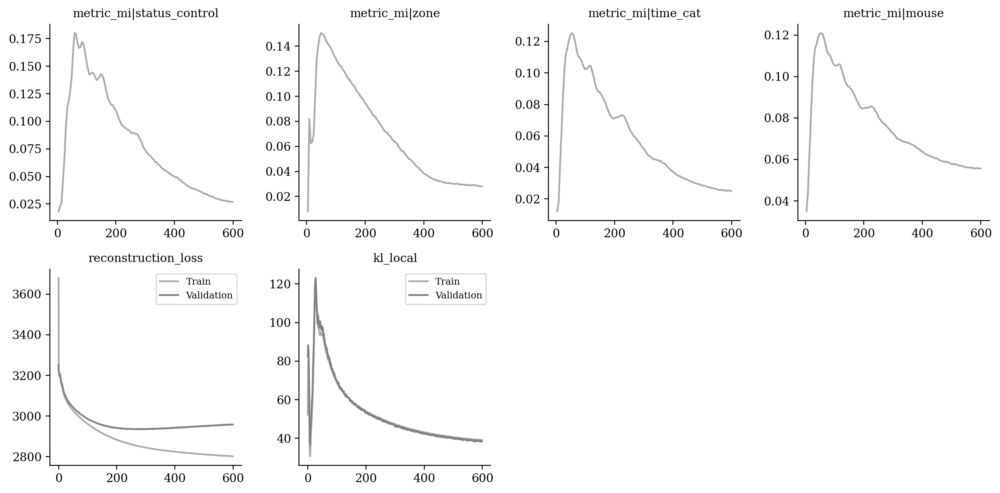

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

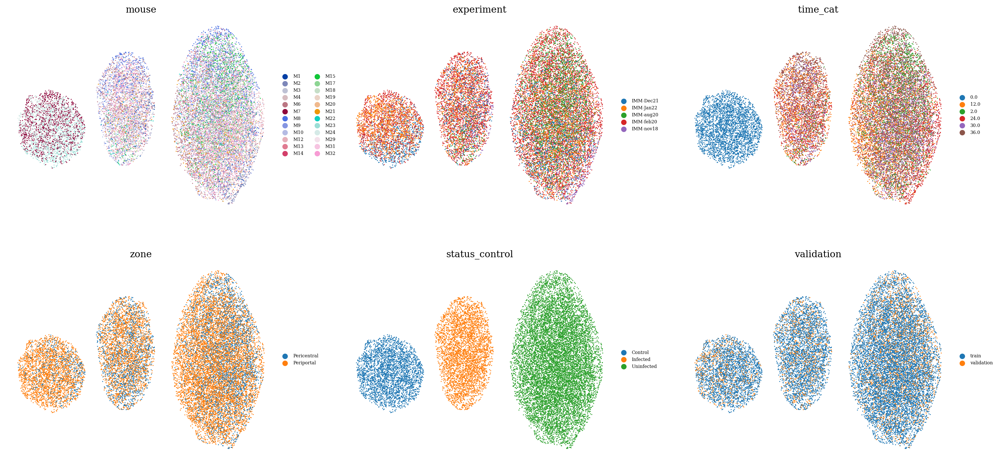

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

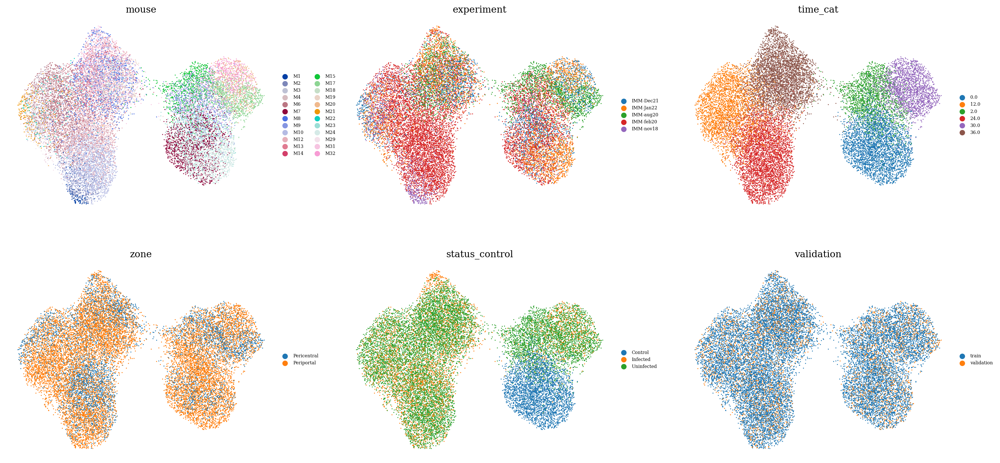

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

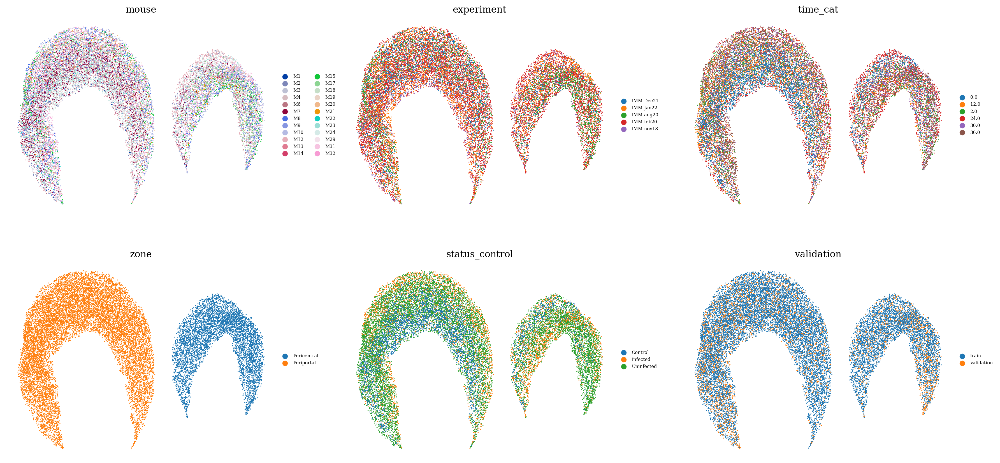

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

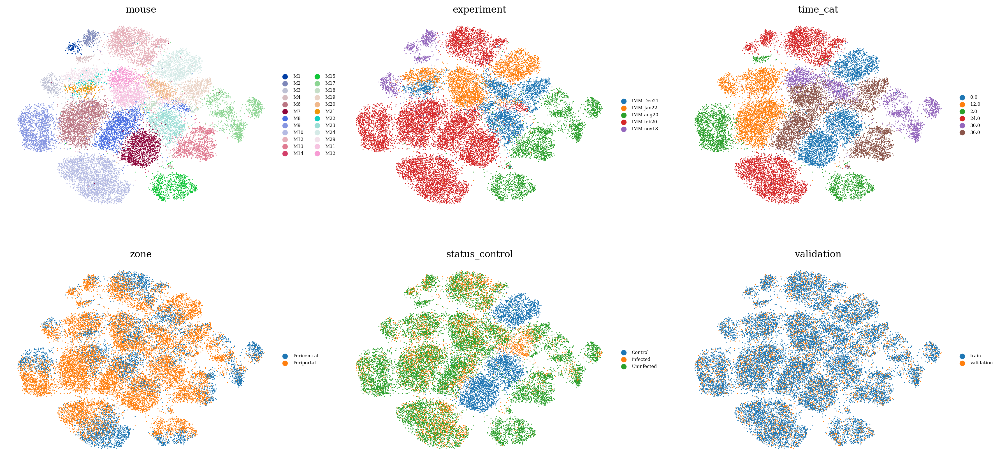

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

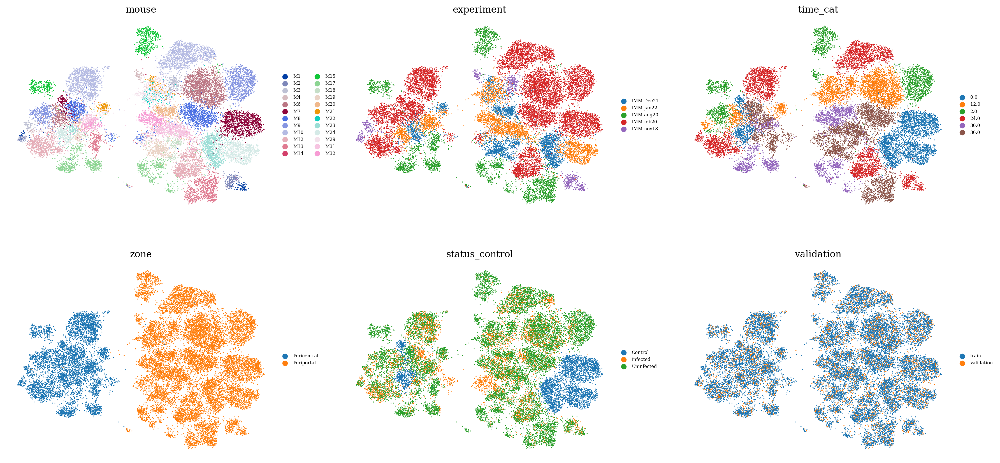

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

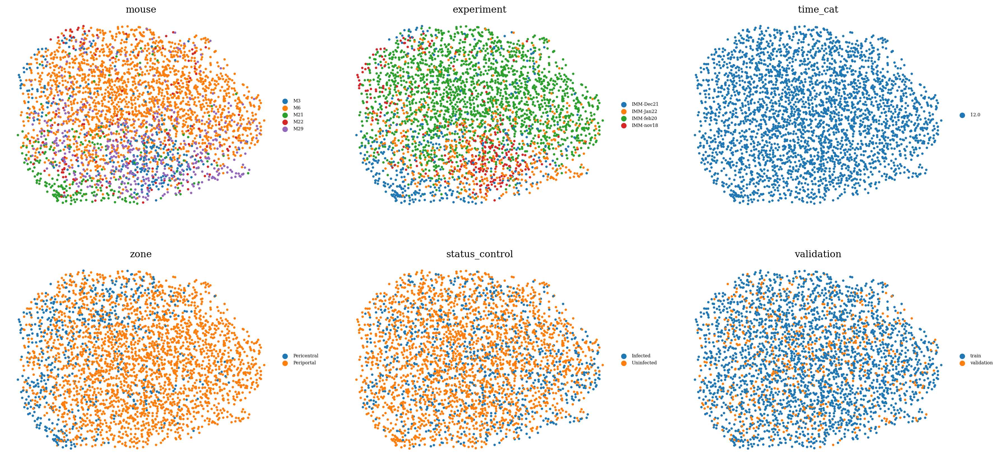

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )